# Afriat

In [1]:
scan=0.1425

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2535,3325,9383
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2535,2564,1701,3469,1612,3362
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4458,10785
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 670,784,2356
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 670,638,407,821,437,837
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1126,2684
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:13:26, 13.37s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:13:26, 13.37s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=43.2]

Epoch 2/600:   0%|          | 1/600 [00:13<2:13:26, 13.37s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=43.2]

Epoch 2/600:   0%|          | 2/600 [00:25<2:07:30, 12.79s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=43.2]

Epoch 2/600:   0%|          | 2/600 [00:25<2:07:30, 12.79s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=59]  

Epoch 3/600:   0%|          | 2/600 [00:25<2:07:30, 12.79s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=59]

Epoch 3/600:   0%|          | 3/600 [00:38<2:04:52, 12.55s/it, v_num=1, total_loss_train=3.23e+3, kl_local_train=59]

Epoch 3/600:   0%|          | 3/600 [00:38<2:04:52, 12.55s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=57.4]

Epoch 4/600:   0%|          | 3/600 [00:38<2:04:52, 12.55s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=57.4]

Epoch 4/600:   1%|          | 4/600 [00:50<2:03:03, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=57.4]

Epoch 4/600:   1%|          | 4/600 [00:50<2:03:03, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 4/600 [00:50<2:03:03, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:54, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=52.4]

Epoch 5/600:   1%|          | 5/600 [01:02<2:02:54, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=45.4]

Epoch 6/600:   1%|          | 5/600 [01:03<2:02:54, 12.39s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=45.4]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=45.4]

Epoch 6/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:15<2:04:32, 12.58s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:48, 12.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=36.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:27<2:01:48, 12.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349] 

Epoch 8/600:   1%|          | 7/600 [01:27<2:01:48, 12.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:39<1:59:52, 12.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=26.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:39<1:59:52, 12.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:39<1:59:52, 12.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=24.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349] 

Epoch 10/600:   2%|▏         | 9/600 [01:50<1:58:13, 12.00s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:57:29, 11.95s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=23, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:02<1:57:29, 11.95s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:03<1:57:29, 11.95s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:21, 12.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=28.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00779, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:15<2:00:21, 12.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529] 

Epoch 12/600:   2%|▏         | 11/600 [02:15<2:00:21, 12.26s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:58:28, 12.09s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=34.8, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 12/600:   2%|▏         | 12/600 [02:27<1:58:28, 12.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 13/600:   2%|▏         | 12/600 [02:27<1:58:28, 12.09s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 13/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 13/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 14/600:   2%|▏         | 13/600 [02:38<1:57:08, 11.97s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:55:43, 11.85s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 14/600:   2%|▏         | 14/600 [02:50<1:55:43, 11.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 15/600:   2%|▏         | 14/600 [02:50<1:55:43, 11.85s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:54:30, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=58.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 15/600:   2%|▎         | 15/600 [03:02<1:54:30, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 16/600:   2%|▎         | 15/600 [03:03<1:54:30, 11.74s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 16/600:   3%|▎         | 16/600 [03:14<1:56:59, 12.02s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=64.1, metric_mi|status_control_train=0.0294, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0317, metric_mi|mouse_train=0.0529]

Epoch 16/600:   3%|▎         | 16/600 [03:14<1:56:59, 12.02s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 16/600 [03:14<1:56:59, 12.02s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 17/600 [03:26<1:55:12, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=70.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 17/600:   3%|▎         | 17/600 [03:26<1:55:12, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 17/600 [03:26<1:55:12, 11.86s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 18/600 [03:37<1:53:47, 11.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 18/600:   3%|▎         | 18/600 [03:37<1:53:47, 11.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 19/600:   3%|▎         | 18/600 [03:37<1:53:47, 11.73s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 19/600:   3%|▎         | 19/600 [03:48<1:52:36, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 19/600:   3%|▎         | 19/600 [03:48<1:52:36, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 19/600 [03:48<1:52:36, 11.63s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 20/600 [04:00<1:52:14, 11.61s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=90.2, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 20/600:   3%|▎         | 20/600 [04:00<1:52:14, 11.61s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]  

Epoch 21/600:   3%|▎         | 20/600 [04:01<1:52:14, 11.61s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 21/600:   4%|▎         | 21/600 [04:13<1:55:34, 11.98s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0625, metric_mi|time_cat_train=0.0613, metric_mi|mouse_train=0.0816]

Epoch 21/600:   4%|▎         | 21/600 [04:13<1:55:34, 11.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103] 

Epoch 22/600:   4%|▎         | 21/600 [04:13<1:55:34, 11.98s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [04:25<1:54:51, 11.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [04:25<1:54:51, 11.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▎         | 22/600 [04:25<1:54:51, 11.92s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [04:36<1:54:17, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=105, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [04:36<1:54:17, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 23/600 [04:37<1:54:17, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [04:48<1:53:57, 11.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=110, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [04:48<1:53:57, 11.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 24/600 [04:48<1:53:57, 11.87s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:00<1:53:55, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:00<1:53:55, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 25/600 [05:02<1:53:55, 11.89s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [05:13<1:57:16, 12.26s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=113, metric_mi|status_control_train=0.0777, metric_mi|zone_train=0.074, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [05:13<1:57:16, 12.26s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]  

Epoch 27/600:   4%|▍         | 26/600 [05:13<1:57:16, 12.26s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 27/600:   4%|▍         | 27/600 [05:25<1:55:38, 12.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 27/600:   4%|▍         | 27/600 [05:25<1:55:38, 12.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 28/600:   4%|▍         | 27/600 [05:25<1:55:38, 12.11s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 28/600:   5%|▍         | 28/600 [05:37<1:54:28, 12.01s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=114, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 28/600:   5%|▍         | 28/600 [05:37<1:54:28, 12.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 29/600:   5%|▍         | 28/600 [05:37<1:54:28, 12.01s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 29/600:   5%|▍         | 29/600 [05:49<1:53:35, 11.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 29/600:   5%|▍         | 29/600 [05:49<1:53:35, 11.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▍         | 29/600 [05:49<1:53:35, 11.94s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▌         | 30/600 [06:01<1:53:28, 11.95s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=116, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 30/600:   5%|▌         | 30/600 [06:01<1:53:28, 11.95s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 30/600 [06:02<1:53:28, 11.95s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 31/600 [06:14<1:57:07, 12.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0952, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.114]

Epoch 31/600:   5%|▌         | 31/600 [06:14<1:57:07, 12.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 31/600 [06:14<1:57:07, 12.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [06:26<1:55:19, 12.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 32/600:   5%|▌         | 32/600 [06:26<1:55:19, 12.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 33/600:   5%|▌         | 32/600 [06:26<1:55:19, 12.18s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [06:38<1:54:02, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 33/600:   6%|▌         | 33/600 [06:38<1:54:02, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 33/600 [06:38<1:54:02, 12.07s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [06:49<1:53:01, 11.98s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=114, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 34/600:   6%|▌         | 34/600 [06:49<1:53:01, 11.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 34/600 [06:49<1:53:01, 11.98s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [07:01<1:52:22, 11.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 35/600:   6%|▌         | 35/600 [07:01<1:52:22, 11.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 35/600 [07:02<1:52:22, 11.93s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [07:14<1:55:17, 12.27s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.118]

Epoch 36/600:   6%|▌         | 36/600 [07:14<1:55:17, 12.27s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 36/600 [07:14<1:55:17, 12.27s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:26<1:53:47, 12.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=115, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 37/600:   6%|▌         | 37/600 [07:26<1:53:47, 12.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▌         | 37/600 [07:26<1:53:47, 12.13s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [07:38<1:52:37, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 38/600:   6%|▋         | 38/600 [07:38<1:52:37, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 38/600 [07:38<1:52:37, 12.02s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [07:50<1:51:48, 11.96s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 39/600:   6%|▋         | 39/600 [07:50<1:51:48, 11.96s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122] 

Epoch 40/600:   6%|▋         | 39/600 [07:50<1:51:48, 11.96s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:01<1:51:09, 11.91s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 40/600:   7%|▋         | 40/600 [08:01<1:51:09, 11.91s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 40/600 [08:03<1:51:09, 11.91s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:14<1:54:10, 12.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=114, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.122]

Epoch 41/600:   7%|▋         | 41/600 [08:14<1:54:10, 12.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 41/600 [08:14<1:54:10, 12.26s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:26<1:52:41, 12.12s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 42/600:   7%|▋         | 42/600 [08:26<1:52:41, 12.12s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 42/600 [08:26<1:52:41, 12.12s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [08:38<1:51:42, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=112, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 43/600:   7%|▋         | 43/600 [08:38<1:51:42, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 43/600 [08:38<1:51:42, 12.03s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [08:50<1:50:53, 11.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=113, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 44/600:   7%|▋         | 44/600 [08:50<1:50:53, 11.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 45/600:   7%|▋         | 44/600 [08:50<1:50:53, 11.97s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:02<1:50:26, 11.94s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=115, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 45/600:   8%|▊         | 45/600 [09:02<1:50:26, 11.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 45/600 [09:03<1:50:26, 11.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:15<1:53:44, 12.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.126]

Epoch 46/600:   8%|▊         | 46/600 [09:15<1:53:44, 12.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128] 

Epoch 47/600:   8%|▊         | 46/600 [09:15<1:53:44, 12.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 47/600:   8%|▊         | 47/600 [09:27<1:52:23, 12.19s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=115, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 47/600:   8%|▊         | 47/600 [09:27<1:52:23, 12.19s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 47/600 [09:27<1:52:23, 12.19s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 48/600 [09:39<1:51:14, 12.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 48/600:   8%|▊         | 48/600 [09:39<1:51:14, 12.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 48/600 [09:39<1:51:14, 12.09s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 49/600 [09:51<1:51:19, 12.12s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 49/600:   8%|▊         | 49/600 [09:51<1:51:19, 12.12s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 49/600 [09:51<1:51:19, 12.12s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 50/600 [10:05<1:56:33, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=112, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 50/600:   8%|▊         | 50/600 [10:05<1:56:33, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 50/600 [10:06<1:56:33, 12.71s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 51/600 [10:20<2:03:15, 13.47s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=114, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 51/600:   8%|▊         | 51/600 [10:20<2:03:15, 13.47s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]  

Epoch 52/600:   8%|▊         | 51/600 [10:20<2:03:15, 13.47s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|▊         | 52/600 [10:34<2:04:25, 13.62s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 52/600:   9%|▊         | 52/600 [10:34<2:04:25, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|▊         | 52/600 [10:34<2:04:25, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|▉         | 53/600 [10:48<2:05:09, 13.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 53/600:   9%|▉         | 53/600 [10:48<2:05:09, 13.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 53/600 [10:48<2:05:09, 13.73s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 54/600 [11:02<2:05:35, 13.80s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 54/600:   9%|▉         | 54/600 [11:02<2:05:35, 13.80s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 54/600 [11:02<2:05:35, 13.80s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 55/600 [11:16<2:06:46, 13.96s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=109, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 55/600:   9%|▉         | 55/600 [11:16<2:06:46, 13.96s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 55/600 [11:18<2:06:46, 13.96s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 56/600 [11:32<2:10:04, 14.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=110, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.13]

Epoch 56/600:   9%|▉         | 56/600 [11:32<2:10:04, 14.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 57/600:   9%|▉         | 56/600 [11:32<2:10:04, 14.35s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:46<2:08:50, 14.24s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [11:46<2:08:50, 14.24s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 57/600 [11:46<2:08:50, 14.24s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:00<2:07:57, 14.17s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [12:00<2:07:57, 14.17s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129] 

Epoch 59/600:  10%|▉         | 58/600 [12:00<2:07:57, 14.17s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [12:14<2:07:12, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [12:14<2:07:12, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|▉         | 59/600 [12:14<2:07:12, 14.11s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:28<2:07:09, 14.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [12:28<2:07:09, 14.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 60/600 [12:29<2:07:09, 14.13s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:43<2:09:56, 14.46s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [12:43<2:09:56, 14.46s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 61/600 [12:43<2:09:56, 14.46s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 62/600 [12:57<2:08:22, 14.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 62/600:  10%|█         | 62/600 [12:57<2:08:22, 14.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 62/600 [12:57<2:08:22, 14.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 63/600 [13:11<2:07:14, 14.22s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 63/600:  10%|█         | 63/600 [13:11<2:07:14, 14.22s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 64/600:  10%|█         | 63/600 [13:11<2:07:14, 14.22s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 64/600:  11%|█         | 64/600 [13:25<2:06:23, 14.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 64/600:  11%|█         | 64/600 [13:25<2:06:23, 14.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 64/600 [13:25<2:06:23, 14.15s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 65/600 [13:39<2:05:40, 14.10s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.6, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 65/600:  11%|█         | 65/600 [13:39<2:05:40, 14.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 66/600:  11%|█         | 65/600 [13:40<2:05:40, 14.10s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 66/600:  11%|█         | 66/600 [13:54<2:08:32, 14.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.5, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.126]

Epoch 66/600:  11%|█         | 66/600 [13:54<2:08:32, 14.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 66/600 [13:54<2:08:32, 14.44s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 67/600 [14:08<2:07:07, 14.31s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=98.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 67/600:  11%|█         | 67/600 [14:08<2:07:07, 14.31s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█         | 67/600 [14:08<2:07:07, 14.31s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█▏        | 68/600 [14:23<2:06:43, 14.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=97.2, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 68/600:  11%|█▏        | 68/600 [14:23<2:06:43, 14.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 69/600:  11%|█▏        | 68/600 [14:23<2:06:43, 14.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|█▏        | 69/600 [14:37<2:05:47, 14.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.5, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 69/600:  12%|█▏        | 69/600 [14:37<2:05:47, 14.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 69/600 [14:37<2:05:47, 14.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 70/600 [14:51<2:05:55, 14.25s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.3, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 70/600:  12%|█▏        | 70/600 [14:51<2:05:55, 14.25s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 70/600 [14:52<2:05:55, 14.25s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 71/600 [15:06<2:08:25, 14.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=95.4, metric_mi|status_control_train=0.185, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.125]

Epoch 71/600:  12%|█▏        | 71/600 [15:06<2:08:25, 14.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 71/600 [15:06<2:08:25, 14.57s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [15:21<2:09:13, 14.68s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=93.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 72/600:  12%|█▏        | 72/600 [15:21<2:09:13, 14.68s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 72/600 [15:21<2:09:13, 14.68s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [15:35<2:07:02, 14.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 73/600:  12%|█▏        | 73/600 [15:35<2:07:02, 14.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 73/600 [15:35<2:07:02, 14.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [15:49<2:05:25, 14.31s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 74/600:  12%|█▏        | 74/600 [15:49<2:05:25, 14.31s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▏        | 74/600 [15:49<2:05:25, 14.31s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:03<2:04:34, 14.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 75/600:  12%|█▎        | 75/600 [16:03<2:04:34, 14.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 76/600:  12%|█▎        | 75/600 [16:04<2:04:34, 14.24s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:18<2:06:55, 14.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=91.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.122]

Epoch 76/600:  13%|█▎        | 76/600 [16:18<2:06:55, 14.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]  

Epoch 77/600:  13%|█▎        | 76/600 [16:18<2:06:55, 14.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 77/600:  13%|█▎        | 77/600 [16:32<2:05:03, 14.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=90, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 77/600:  13%|█▎        | 77/600 [16:32<2:05:03, 14.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 78/600:  13%|█▎        | 77/600 [16:32<2:05:03, 14.35s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 78/600:  13%|█▎        | 78/600 [16:46<2:03:39, 14.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=89.3, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 78/600:  13%|█▎        | 78/600 [16:46<2:03:39, 14.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 79/600:  13%|█▎        | 78/600 [16:46<2:03:39, 14.21s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 79/600:  13%|█▎        | 79/600 [17:00<2:02:35, 14.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=88.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 79/600:  13%|█▎        | 79/600 [17:00<2:02:35, 14.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 80/600:  13%|█▎        | 79/600 [17:00<2:02:35, 14.12s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 80/600:  13%|█▎        | 80/600 [17:14<2:01:44, 14.05s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=87.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 80/600:  13%|█▎        | 80/600 [17:14<2:01:44, 14.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 81/600:  13%|█▎        | 80/600 [17:15<2:01:44, 14.05s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 81/600:  14%|█▎        | 81/600 [17:29<2:04:17, 14.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 81/600:  14%|█▎        | 81/600 [17:29<2:04:17, 14.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 81/600 [17:29<2:04:17, 14.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [17:43<2:02:44, 14.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.9, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 82/600:  14%|█▎        | 82/600 [17:43<2:02:44, 14.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▎        | 82/600 [17:43<2:02:44, 14.22s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [17:57<2:01:37, 14.12s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=86.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 83/600:  14%|█▍        | 83/600 [17:57<2:01:37, 14.12s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 83/600 [17:57<2:01:37, 14.12s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [18:11<2:00:45, 14.04s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 84/600:  14%|█▍        | 84/600 [18:11<2:00:45, 14.04s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 84/600 [18:11<2:00:45, 14.04s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [18:25<2:00:08, 14.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=85.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 85/600:  14%|█▍        | 85/600 [18:25<2:00:08, 14.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 85/600 [18:26<2:00:08, 14.00s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [18:40<2:02:48, 14.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 86/600:  14%|█▍        | 86/600 [18:40<2:02:48, 14.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 87/600:  14%|█▍        | 86/600 [18:40<2:02:48, 14.34s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 87/600:  14%|█▍        | 87/600 [18:54<2:01:29, 14.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 87/600:  14%|█▍        | 87/600 [18:54<2:01:29, 14.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 88/600:  14%|█▍        | 87/600 [18:54<2:01:29, 14.21s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 88/600:  15%|█▍        | 88/600 [19:08<2:00:33, 14.13s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=84.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 88/600:  15%|█▍        | 88/600 [19:08<2:00:33, 14.13s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 88/600 [19:08<2:00:33, 14.13s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 89/600 [19:21<1:59:53, 14.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 89/600:  15%|█▍        | 89/600 [19:21<1:59:53, 14.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▍        | 89/600 [19:22<1:59:53, 14.08s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▌        | 90/600 [19:36<2:00:27, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 90/600:  15%|█▌        | 90/600 [19:36<2:00:27, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 90/600 [19:37<2:00:27, 14.17s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 91/600 [19:51<2:02:52, 14.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=82.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.118]

Epoch 91/600:  15%|█▌        | 91/600 [19:51<2:02:52, 14.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|█▌        | 91/600 [19:51<2:02:52, 14.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|█▌        | 92/600 [20:05<2:01:12, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 92/600:  15%|█▌        | 92/600 [20:05<2:01:12, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 93/600:  15%|█▌        | 92/600 [20:05<2:01:12, 14.32s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 93/600:  16%|█▌        | 93/600 [20:17<1:54:46, 13.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=81.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 93/600:  16%|█▌        | 93/600 [20:17<1:54:46, 13.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|█▌        | 93/600 [20:17<1:54:46, 13.58s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|█▌        | 94/600 [20:29<1:50:07, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 94/600:  16%|█▌        | 94/600 [20:29<1:50:07, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|█▌        | 94/600 [20:29<1:50:07, 13.06s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|█▌        | 95/600 [20:40<1:46:38, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 95/600:  16%|█▌        | 95/600 [20:40<1:46:38, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|█▌        | 95/600 [20:42<1:46:38, 12.67s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|█▌        | 96/600 [20:54<1:47:20, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=80.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.119]

Epoch 96/600:  16%|█▌        | 96/600 [20:54<1:47:20, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]  

Epoch 97/600:  16%|█▌        | 96/600 [20:54<1:47:20, 12.78s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 97/600:  16%|█▌        | 97/600 [21:05<1:44:38, 12.48s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=79.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 97/600:  16%|█▌        | 97/600 [21:05<1:44:38, 12.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|█▌        | 97/600 [21:05<1:44:38, 12.48s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|█▋        | 98/600 [21:17<1:42:39, 12.27s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 98/600:  16%|█▋        | 98/600 [21:17<1:42:39, 12.27s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|█▋        | 98/600 [21:17<1:42:39, 12.27s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|█▋        | 99/600 [21:29<1:41:13, 12.12s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.4, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 99/600:  16%|█▋        | 99/600 [21:29<1:41:13, 12.12s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 100/600:  16%|█▋        | 99/600 [21:29<1:41:13, 12.12s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 100/600:  17%|█▋        | 100/600 [21:41<1:40:08, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=78.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 100/600:  17%|█▋        | 100/600 [21:41<1:40:08, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|█▋        | 100/600 [21:42<1:40:08, 12.02s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|█▋        | 101/600 [21:54<1:42:25, 12.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.118]

Epoch 101/600:  17%|█▋        | 101/600 [21:54<1:42:25, 12.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 101/600 [21:54<1:42:25, 12.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 102/600 [22:05<1:40:52, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 102/600:  17%|█▋        | 102/600 [22:05<1:40:52, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]  

Epoch 103/600:  17%|█▋        | 102/600 [22:05<1:40:52, 12.15s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|█▋        | 103/600 [22:17<1:39:44, 12.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 103/600:  17%|█▋        | 103/600 [22:17<1:39:44, 12.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 103/600 [22:17<1:39:44, 12.04s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 104/600 [22:29<1:38:53, 11.96s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=77.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 104/600:  17%|█▋        | 104/600 [22:29<1:38:53, 11.96s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  17%|█▋        | 104/600 [22:29<1:38:53, 11.96s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|█▊        | 105/600 [22:41<1:38:04, 11.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=76.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 105/600:  18%|█▊        | 105/600 [22:41<1:38:04, 11.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 105/600 [22:42<1:38:04, 11.89s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 106/600 [22:54<1:40:34, 12.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.116]

Epoch 106/600:  18%|█▊        | 106/600 [22:54<1:40:34, 12.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 106/600 [22:54<1:40:34, 12.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 107/600 [23:05<1:39:15, 12.08s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=75.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 107/600:  18%|█▊        | 107/600 [23:05<1:39:15, 12.08s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 107/600 [23:05<1:39:15, 12.08s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 108/600 [23:17<1:38:18, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 108/600:  18%|█▊        | 108/600 [23:17<1:38:18, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 108/600 [23:17<1:38:18, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 109/600 [23:29<1:37:33, 11.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 109/600:  18%|█▊        | 109/600 [23:29<1:37:33, 11.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 109/600 [23:29<1:37:33, 11.92s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 110/600 [23:41<1:36:54, 11.87s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 110/600:  18%|█▊        | 110/600 [23:41<1:36:54, 11.87s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 110/600 [23:42<1:36:54, 11.87s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 111/600 [23:54<1:39:23, 12.20s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.114]

Epoch 111/600:  18%|█▊        | 111/600 [23:54<1:39:23, 12.20s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 112/600:  18%|█▊        | 111/600 [23:54<1:39:23, 12.20s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 112/600:  19%|█▊        | 112/600 [24:05<1:38:07, 12.06s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=74.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 112/600:  19%|█▊        | 112/600 [24:05<1:38:07, 12.06s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|█▊        | 112/600 [24:05<1:38:07, 12.06s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|█▉        | 113/600 [24:17<1:37:07, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 113/600:  19%|█▉        | 113/600 [24:17<1:37:07, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|█▉        | 113/600 [24:17<1:37:07, 11.97s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|█▉        | 114/600 [24:29<1:37:05, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 114/600:  19%|█▉        | 114/600 [24:29<1:37:05, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|█▉        | 114/600 [24:29<1:37:05, 11.99s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|█▉        | 115/600 [24:41<1:36:18, 11.91s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73.1, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 115/600:  19%|█▉        | 115/600 [24:41<1:36:18, 11.91s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]  

Epoch 116/600:  19%|█▉        | 115/600 [24:42<1:36:18, 11.91s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 116/600:  19%|█▉        | 116/600 [24:54<1:38:46, 12.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=73, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.113]

Epoch 116/600:  19%|█▉        | 116/600 [24:54<1:38:46, 12.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  19%|█▉        | 116/600 [24:54<1:38:46, 12.24s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|█▉        | 117/600 [25:06<1:37:23, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 117/600:  20%|█▉        | 117/600 [25:06<1:37:23, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]  

Epoch 118/600:  20%|█▉        | 117/600 [25:06<1:37:23, 12.10s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|█▉        | 118/600 [25:18<1:36:26, 12.01s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=72, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 118/600:  20%|█▉        | 118/600 [25:18<1:36:26, 12.01s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 118/600 [25:18<1:36:26, 12.01s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 119/600 [25:29<1:35:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71.6, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 119/600:  20%|█▉        | 119/600 [25:29<1:35:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|█▉        | 119/600 [25:29<1:35:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|██        | 120/600 [25:41<1:34:56, 11.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 120/600:  20%|██        | 120/600 [25:41<1:34:56, 11.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]  

Epoch 121/600:  20%|██        | 120/600 [25:42<1:34:56, 11.87s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|██        | 121/600 [25:54<1:37:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=71, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.112]

Epoch 121/600:  20%|██        | 121/600 [25:54<1:37:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 121/600 [25:54<1:37:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 122/600 [26:06<1:36:18, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 122/600:  20%|██        | 122/600 [26:06<1:36:18, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 122/600 [26:06<1:36:18, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 123/600 [26:18<1:35:21, 11.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 123/600:  20%|██        | 123/600 [26:18<1:35:21, 11.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 124/600:  20%|██        | 123/600 [26:18<1:35:21, 11.99s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|██        | 124/600 [26:29<1:34:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 124/600:  21%|██        | 124/600 [26:29<1:34:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 124/600 [26:29<1:34:37, 11.93s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 125/600 [26:41<1:34:09, 11.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 125/600:  21%|██        | 125/600 [26:41<1:34:09, 11.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 125/600 [26:42<1:34:09, 11.89s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 126/600 [26:54<1:36:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.113]

Epoch 126/600:  21%|██        | 126/600 [26:54<1:36:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|██        | 126/600 [26:54<1:36:34, 12.22s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|██        | 127/600 [27:06<1:35:16, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 127/600:  21%|██        | 127/600 [27:06<1:35:16, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██        | 127/600 [27:06<1:35:16, 12.09s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██▏       | 128/600 [27:18<1:34:15, 11.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=69.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 128/600:  21%|██▏       | 128/600 [27:18<1:34:15, 11.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 129/600:  21%|██▏       | 128/600 [27:18<1:34:15, 11.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|██▏       | 129/600 [27:29<1:33:28, 11.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.8, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 129/600:  22%|██▏       | 129/600 [27:29<1:33:28, 11.91s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 129/600 [27:29<1:33:28, 11.91s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 130/600 [27:41<1:32:03, 11.75s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 130/600:  22%|██▏       | 130/600 [27:41<1:32:03, 11.75s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 130/600 [27:42<1:32:03, 11.75s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 131/600 [27:53<1:34:01, 12.03s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.111]

Epoch 131/600:  22%|██▏       | 131/600 [27:53<1:34:01, 12.03s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11] 

Epoch 132/600:  22%|██▏       | 131/600 [27:53<1:34:01, 12.03s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 132/600:  22%|██▏       | 132/600 [28:05<1:32:36, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 132/600:  22%|██▏       | 132/600 [28:05<1:32:36, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|██▏       | 132/600 [28:05<1:32:36, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|██▏       | 133/600 [28:16<1:31:23, 11.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 133/600:  22%|██▏       | 133/600 [28:16<1:31:23, 11.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|██▏       | 133/600 [28:16<1:31:23, 11.74s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|██▏       | 134/600 [28:28<1:30:29, 11.65s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 134/600:  22%|██▏       | 134/600 [28:28<1:30:29, 11.65s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|██▏       | 134/600 [28:28<1:30:29, 11.65s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|██▎       | 135/600 [28:39<1:29:41, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 135/600:  22%|██▎       | 135/600 [28:39<1:29:41, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 136/600:  22%|██▎       | 135/600 [28:40<1:29:41, 11.57s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 136/600:  23%|██▎       | 136/600 [28:52<1:32:03, 11.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 136/600:  23%|██▎       | 136/600 [28:52<1:32:03, 11.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109] 

Epoch 137/600:  23%|██▎       | 136/600 [28:52<1:32:03, 11.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 137/600:  23%|██▎       | 137/600 [29:04<1:31:35, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=67, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 137/600:  23%|██▎       | 137/600 [29:04<1:31:35, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 137/600 [29:04<1:31:35, 11.87s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 138/600 [29:15<1:31:10, 11.84s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 138/600:  23%|██▎       | 138/600 [29:15<1:31:10, 11.84s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 138/600 [29:16<1:31:10, 11.84s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 139/600 [29:27<1:30:49, 11.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 139/600:  23%|██▎       | 139/600 [29:27<1:30:49, 11.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 139/600 [29:27<1:30:49, 11.82s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 140/600 [29:39<1:30:40, 11.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=66.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 140/600:  23%|██▎       | 140/600 [29:39<1:30:40, 11.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 141/600:  23%|██▎       | 140/600 [29:40<1:30:40, 11.83s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 141/600:  24%|██▎       | 141/600 [29:52<1:33:20, 12.20s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.145, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 141/600:  24%|██▎       | 141/600 [29:52<1:33:20, 12.20s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]   

Epoch 142/600:  24%|██▎       | 141/600 [29:52<1:33:20, 12.20s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 142/600:  24%|██▎       | 142/600 [30:04<1:32:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=66, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 142/600:  24%|██▎       | 142/600 [30:04<1:32:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 143/600:  24%|██▎       | 142/600 [30:04<1:32:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 143/600:  24%|██▍       | 143/600 [30:16<1:31:17, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 143/600:  24%|██▍       | 143/600 [30:16<1:31:17, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 144/600:  24%|██▍       | 143/600 [30:16<1:31:17, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 144/600:  24%|██▍       | 144/600 [30:28<1:30:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.6, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 144/600:  24%|██▍       | 144/600 [30:28<1:30:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 145/600:  24%|██▍       | 144/600 [30:28<1:30:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 145/600:  24%|██▍       | 145/600 [30:39<1:29:56, 11.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 145/600:  24%|██▍       | 145/600 [30:39<1:29:56, 11.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 146/600:  24%|██▍       | 145/600 [30:40<1:29:56, 11.86s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 146/600:  24%|██▍       | 146/600 [30:52<1:32:19, 12.20s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65.2, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.11]

Epoch 146/600:  24%|██▍       | 146/600 [30:52<1:32:19, 12.20s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]   

Epoch 147/600:  24%|██▍       | 146/600 [30:52<1:32:19, 12.20s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 147/600:  24%|██▍       | 147/600 [31:04<1:31:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 147/600:  24%|██▍       | 147/600 [31:04<1:31:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 148/600:  24%|██▍       | 147/600 [31:04<1:31:09, 12.07s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 148/600:  25%|██▍       | 148/600 [31:16<1:30:15, 11.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 148/600:  25%|██▍       | 148/600 [31:16<1:30:15, 11.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|██▍       | 148/600 [31:16<1:30:15, 11.98s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|██▍       | 149/600 [31:28<1:29:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 149/600:  25%|██▍       | 149/600 [31:28<1:29:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|██▍       | 149/600 [31:28<1:29:35, 11.92s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|██▌       | 150/600 [31:39<1:29:03, 11.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 150/600:  25%|██▌       | 150/600 [31:39<1:29:03, 11.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|██▌       | 150/600 [31:41<1:29:03, 11.87s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|██▌       | 151/600 [31:52<1:31:28, 12.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.11]

Epoch 151/600:  25%|██▌       | 151/600 [31:52<1:31:28, 12.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 152/600:  25%|██▌       | 151/600 [31:52<1:31:28, 12.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 152/600:  25%|██▌       | 152/600 [32:04<1:30:13, 12.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=64, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 152/600:  25%|██▌       | 152/600 [32:04<1:30:13, 12.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 153/600:  25%|██▌       | 152/600 [32:04<1:30:13, 12.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 153/600:  26%|██▌       | 153/600 [32:16<1:29:19, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.7, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 153/600:  26%|██▌       | 153/600 [32:16<1:29:19, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 154/600:  26%|██▌       | 153/600 [32:16<1:29:19, 11.99s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 154/600:  26%|██▌       | 154/600 [32:28<1:28:41, 11.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 154/600:  26%|██▌       | 154/600 [32:28<1:28:41, 11.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 155/600:  26%|██▌       | 154/600 [32:28<1:28:41, 11.93s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 155/600:  26%|██▌       | 155/600 [32:39<1:28:04, 11.88s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=63.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 155/600:  26%|██▌       | 155/600 [32:39<1:28:04, 11.88s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109] 

Epoch 156/600:  26%|██▌       | 155/600 [32:41<1:28:04, 11.88s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 156/600:  26%|██▌       | 156/600 [32:52<1:30:24, 12.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.139, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.109]

Epoch 156/600:  26%|██▌       | 156/600 [32:52<1:30:24, 12.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 157/600:  26%|██▌       | 156/600 [32:52<1:30:24, 12.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 157/600:  26%|██▌       | 157/600 [33:04<1:29:14, 12.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=63.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 157/600:  26%|██▌       | 157/600 [33:04<1:29:14, 12.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 158/600:  26%|██▌       | 157/600 [33:04<1:29:14, 12.09s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 158/600:  26%|██▋       | 158/600 [33:16<1:28:21, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 158/600:  26%|██▋       | 158/600 [33:16<1:28:21, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 159/600:  26%|██▋       | 158/600 [33:16<1:28:21, 11.99s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 159/600:  26%|██▋       | 159/600 [33:28<1:27:40, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 159/600:  26%|██▋       | 159/600 [33:28<1:27:40, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 160/600:  26%|██▋       | 159/600 [33:28<1:27:40, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 160/600:  27%|██▋       | 160/600 [33:39<1:27:00, 11.87s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 160/600:  27%|██▋       | 160/600 [33:39<1:27:00, 11.87s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 161/600:  27%|██▋       | 160/600 [33:41<1:27:00, 11.87s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 161/600:  27%|██▋       | 161/600 [33:52<1:29:18, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.107]

Epoch 161/600:  27%|██▋       | 161/600 [33:52<1:29:18, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 161/600 [33:53<1:29:18, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 162/600 [34:04<1:28:21, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 162/600:  27%|██▋       | 162/600 [34:04<1:28:21, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 162/600 [34:04<1:28:21, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 163/600 [34:16<1:27:25, 12.00s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 163/600:  27%|██▋       | 163/600 [34:16<1:27:25, 12.00s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 163/600 [34:16<1:27:25, 12.00s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 164/600 [34:28<1:26:44, 11.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62.2, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 164/600:  27%|██▋       | 164/600 [34:28<1:26:44, 11.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]  

Epoch 165/600:  27%|██▋       | 164/600 [34:28<1:26:44, 11.94s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 165/600:  28%|██▊       | 165/600 [34:40<1:26:28, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=62, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 165/600:  28%|██▊       | 165/600 [34:40<1:26:28, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 166/600:  28%|██▊       | 165/600 [34:41<1:26:28, 11.93s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 166/600:  28%|██▊       | 166/600 [34:53<1:28:38, 12.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 166/600:  28%|██▊       | 166/600 [34:53<1:28:38, 12.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██▊       | 166/600 [34:53<1:28:38, 12.25s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██▊       | 167/600 [35:05<1:27:24, 12.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.6, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 167/600:  28%|██▊       | 167/600 [35:05<1:27:24, 12.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██▊       | 167/600 [35:05<1:27:24, 12.11s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██▊       | 168/600 [35:16<1:26:26, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 168/600:  28%|██▊       | 168/600 [35:16<1:26:26, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██▊       | 168/600 [35:16<1:26:26, 12.01s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██▊       | 169/600 [35:29<1:27:42, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.4, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 169/600:  28%|██▊       | 169/600 [35:29<1:27:42, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██▊       | 169/600 [35:29<1:27:42, 12.21s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██▊       | 170/600 [35:41<1:26:43, 12.10s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=61.3, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 170/600:  28%|██▊       | 170/600 [35:41<1:26:43, 12.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|██▊       | 170/600 [35:42<1:26:43, 12.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:29:16, 12.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.9, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.105]

Epoch 171/600:  28%|██▊       | 171/600 [35:54<1:29:16, 12.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104] 

Epoch 172/600:  28%|██▊       | 171/600 [35:54<1:29:16, 12.49s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 172/600:  29%|██▊       | 172/600 [36:06<1:28:29, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.8, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 172/600:  29%|██▊       | 172/600 [36:06<1:28:29, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 173/600:  29%|██▊       | 172/600 [36:07<1:28:29, 12.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:27:48, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.5, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 173/600:  29%|██▉       | 173/600 [36:19<1:27:48, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 174/600:  29%|██▉       | 173/600 [36:19<1:27:48, 12.34s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:27:17, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 174/600:  29%|██▉       | 174/600 [36:31<1:27:17, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 175/600:  29%|██▉       | 174/600 [36:31<1:27:17, 12.30s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 175/600:  29%|██▉       | 175/600 [36:43<1:26:35, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.4, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 175/600:  29%|██▉       | 175/600 [36:43<1:26:35, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 176/600:  29%|██▉       | 175/600 [36:44<1:26:35, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 176/600:  29%|██▉       | 176/600 [36:56<1:28:55, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60.2, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.104]

Epoch 176/600:  29%|██▉       | 176/600 [36:56<1:28:55, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 177/600:  29%|██▉       | 176/600 [36:56<1:28:55, 12.58s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 177/600:  30%|██▉       | 177/600 [37:09<1:27:49, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 177/600:  30%|██▉       | 177/600 [37:09<1:27:49, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 178/600:  30%|██▉       | 177/600 [37:09<1:27:49, 12.46s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 178/600:  30%|██▉       | 178/600 [37:21<1:27:02, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=60, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 178/600:  30%|██▉       | 178/600 [37:21<1:27:02, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 179/600:  30%|██▉       | 178/600 [37:21<1:27:02, 12.37s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 179/600:  30%|██▉       | 179/600 [37:33<1:26:25, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 179/600:  30%|██▉       | 179/600 [37:33<1:26:25, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 180/600:  30%|██▉       | 179/600 [37:33<1:26:25, 12.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 180/600:  30%|███       | 180/600 [37:45<1:26:18, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 180/600:  30%|███       | 180/600 [37:45<1:26:18, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 181/600:  30%|███       | 180/600 [37:46<1:26:18, 12.33s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 181/600:  30%|███       | 181/600 [37:59<1:28:28, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.103]

Epoch 181/600:  30%|███       | 181/600 [37:59<1:28:28, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 181/600 [37:59<1:28:28, 12.67s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 182/600 [38:11<1:26:29, 12.42s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 182/600:  30%|███       | 182/600 [38:11<1:26:29, 12.42s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 182/600 [38:11<1:26:29, 12.42s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 183/600 [38:22<1:24:56, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 183/600:  30%|███       | 183/600 [38:22<1:24:56, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 184/600:  30%|███       | 183/600 [38:22<1:24:56, 12.22s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 184/600:  31%|███       | 184/600 [38:34<1:23:45, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 184/600:  31%|███       | 184/600 [38:34<1:23:45, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 184/600 [38:34<1:23:45, 12.08s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 185/600 [38:46<1:23:02, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=59.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 185/600:  31%|███       | 185/600 [38:46<1:23:02, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 185/600 [38:47<1:23:02, 12.01s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 186/600 [38:59<1:24:54, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.124, metric_mi|time_cat_train=0.0948, metric_mi|mouse_train=0.101]

Epoch 186/600:  31%|███       | 186/600 [38:59<1:24:54, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 187/600:  31%|███       | 186/600 [38:59<1:24:54, 12.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 187/600:  31%|███       | 187/600 [39:11<1:23:44, 12.17s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 187/600:  31%|███       | 187/600 [39:11<1:23:44, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 188/600:  31%|███       | 187/600 [39:11<1:23:44, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 188/600:  31%|███▏      | 188/600 [39:23<1:22:49, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 188/600:  31%|███▏      | 188/600 [39:23<1:22:49, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 189/600:  31%|███▏      | 188/600 [39:23<1:22:49, 12.06s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 189/600:  32%|███▏      | 189/600 [39:34<1:22:22, 12.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 189/600:  32%|███▏      | 189/600 [39:34<1:22:22, 12.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 190/600:  32%|███▏      | 189/600 [39:34<1:22:22, 12.03s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 190/600:  32%|███▏      | 190/600 [39:46<1:21:42, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 190/600:  32%|███▏      | 190/600 [39:46<1:21:42, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 191/600:  32%|███▏      | 190/600 [39:48<1:21:42, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 191/600:  32%|███▏      | 191/600 [39:59<1:23:29, 12.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0917, metric_mi|mouse_train=0.0983]

Epoch 191/600:  32%|███▏      | 191/600 [39:59<1:23:29, 12.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 191/600 [39:59<1:23:29, 12.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 192/600 [40:11<1:22:08, 12.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.3, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 192/600:  32%|███▏      | 192/600 [40:11<1:22:08, 12.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 192/600 [40:11<1:22:08, 12.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 193/600 [40:23<1:21:08, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.4, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 193/600:  32%|███▏      | 193/600 [40:23<1:21:08, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 193/600 [40:23<1:21:08, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 194/600 [40:34<1:20:20, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=58.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 194/600:  32%|███▏      | 194/600 [40:34<1:20:20, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▏      | 194/600 [40:34<1:20:20, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▎      | 195/600 [40:46<1:19:40, 11.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 195/600:  32%|███▎      | 195/600 [40:46<1:19:40, 11.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 196/600:  32%|███▎      | 195/600 [40:47<1:19:40, 11.80s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 196/600:  33%|███▎      | 196/600 [40:59<1:21:42, 12.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.0914, metric_mi|mouse_train=0.0981]

Epoch 196/600:  33%|███▎      | 196/600 [40:59<1:21:42, 12.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098] 

Epoch 197/600:  33%|███▎      | 196/600 [40:59<1:21:42, 12.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 197/600:  33%|███▎      | 197/600 [41:10<1:20:35, 12.00s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 197/600:  33%|███▎      | 197/600 [41:10<1:20:35, 12.00s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 198/600:  33%|███▎      | 197/600 [41:10<1:20:35, 12.00s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 198/600:  33%|███▎      | 198/600 [41:22<1:19:44, 11.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 198/600:  33%|███▎      | 198/600 [41:22<1:19:44, 11.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 199/600:  33%|███▎      | 198/600 [41:22<1:19:44, 11.90s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 199/600:  33%|███▎      | 199/600 [41:34<1:19:04, 11.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 199/600:  33%|███▎      | 199/600 [41:34<1:19:04, 11.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 200/600:  33%|███▎      | 199/600 [41:34<1:19:04, 11.83s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 200/600:  33%|███▎      | 200/600 [41:45<1:18:29, 11.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 200/600:  33%|███▎      | 200/600 [41:45<1:18:29, 11.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 201/600:  33%|███▎      | 200/600 [41:47<1:18:29, 11.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 201/600:  34%|███▎      | 201/600 [41:58<1:20:29, 12.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.3, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.0912, metric_mi|mouse_train=0.098]

Epoch 201/600:  34%|███▎      | 201/600 [41:58<1:20:29, 12.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 201/600 [41:58<1:20:29, 12.10s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 202/600 [42:10<1:19:24, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 202/600:  34%|███▎      | 202/600 [42:10<1:19:24, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]  

Epoch 203/600:  34%|███▎      | 202/600 [42:10<1:19:24, 11.97s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 203/600:  34%|███▍      | 203/600 [42:22<1:18:33, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 203/600:  34%|███▍      | 203/600 [42:22<1:18:33, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 203/600 [42:22<1:18:33, 11.87s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 204/600 [42:33<1:17:56, 11.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 204/600:  34%|███▍      | 204/600 [42:33<1:17:56, 11.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 204/600 [42:33<1:17:56, 11.81s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 205/600 [42:45<1:17:21, 11.75s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 205/600:  34%|███▍      | 205/600 [42:45<1:17:21, 11.75s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 205/600 [42:46<1:17:21, 11.75s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 206/600 [42:58<1:19:24, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0968]

Epoch 206/600:  34%|███▍      | 206/600 [42:58<1:19:24, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 207/600:  34%|███▍      | 206/600 [42:58<1:19:24, 12.09s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 207/600:  34%|███▍      | 207/600 [43:09<1:18:20, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 207/600:  34%|███▍      | 207/600 [43:09<1:18:20, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 208/600:  34%|███▍      | 207/600 [43:09<1:18:20, 11.96s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 208/600:  35%|███▍      | 208/600 [43:21<1:17:30, 11.86s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 208/600:  35%|███▍      | 208/600 [43:21<1:17:30, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 209/600:  35%|███▍      | 208/600 [43:21<1:17:30, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 209/600:  35%|███▍      | 209/600 [43:33<1:16:51, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 209/600:  35%|███▍      | 209/600 [43:33<1:16:51, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 210/600:  35%|███▍      | 209/600 [43:33<1:16:51, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 210/600:  35%|███▌      | 210/600 [43:44<1:16:17, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56.1, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 210/600:  35%|███▌      | 210/600 [43:44<1:16:17, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]  

Epoch 211/600:  35%|███▌      | 210/600 [43:46<1:16:17, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 211/600:  35%|███▌      | 211/600 [43:57<1:18:15, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0869, metric_mi|mouse_train=0.0951]

Epoch 211/600:  35%|███▌      | 211/600 [43:57<1:18:15, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 212/600:  35%|███▌      | 211/600 [43:57<1:18:15, 12.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 212/600:  35%|███▌      | 212/600 [44:09<1:17:13, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 212/600:  35%|███▌      | 212/600 [44:09<1:17:13, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 213/600:  35%|███▌      | 212/600 [44:09<1:17:13, 11.94s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 213/600:  36%|███▌      | 213/600 [44:21<1:16:31, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 213/600:  36%|███▌      | 213/600 [44:21<1:16:31, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]  

Epoch 214/600:  36%|███▌      | 213/600 [44:21<1:16:31, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 214/600:  36%|███▌      | 214/600 [44:32<1:16:05, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=56, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 214/600:  36%|███▌      | 214/600 [44:32<1:16:05, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 215/600:  36%|███▌      | 214/600 [44:32<1:16:05, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 215/600:  36%|███▌      | 215/600 [44:44<1:15:39, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 215/600:  36%|███▌      | 215/600 [44:44<1:15:39, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 216/600:  36%|███▌      | 215/600 [44:45<1:15:39, 11.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 216/600:  36%|███▌      | 216/600 [44:57<1:17:43, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.8, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.086, metric_mi|mouse_train=0.0945]

Epoch 216/600:  36%|███▌      | 216/600 [44:57<1:17:43, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 217/600:  36%|███▌      | 216/600 [44:57<1:17:43, 12.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 217/600:  36%|███▌      | 217/600 [45:09<1:16:36, 12.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.7, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 217/600:  36%|███▌      | 217/600 [45:09<1:16:36, 12.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 218/600:  36%|███▌      | 217/600 [45:09<1:16:36, 12.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 218/600:  36%|███▋      | 218/600 [45:20<1:15:45, 11.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 218/600:  36%|███▋      | 218/600 [45:20<1:15:45, 11.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 219/600:  36%|███▋      | 218/600 [45:20<1:15:45, 11.90s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 219/600:  36%|███▋      | 219/600 [45:32<1:15:06, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.5, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 219/600:  36%|███▋      | 219/600 [45:32<1:15:06, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 220/600:  36%|███▋      | 219/600 [45:32<1:15:06, 11.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 220/600:  37%|███▋      | 220/600 [45:44<1:14:31, 11.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 220/600:  37%|███▋      | 220/600 [45:44<1:14:31, 11.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 221/600:  37%|███▋      | 220/600 [45:45<1:14:31, 11.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 221/600:  37%|███▋      | 221/600 [45:56<1:16:28, 12.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0871, metric_mi|mouse_train=0.095]

Epoch 221/600:  37%|███▋      | 221/600 [45:56<1:16:28, 12.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███▋      | 221/600 [45:56<1:16:28, 12.11s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███▋      | 222/600 [46:08<1:15:27, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 222/600:  37%|███▋      | 222/600 [46:08<1:15:27, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]  

Epoch 223/600:  37%|███▋      | 222/600 [46:08<1:15:27, 11.98s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 223/600:  37%|███▋      | 223/600 [46:20<1:14:39, 11.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 223/600:  37%|███▋      | 223/600 [46:20<1:14:39, 11.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███▋      | 223/600 [46:20<1:14:39, 11.88s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███▋      | 224/600 [46:31<1:14:02, 11.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=55, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 224/600:  37%|███▋      | 224/600 [46:31<1:14:02, 11.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 225/600:  37%|███▋      | 224/600 [46:31<1:14:02, 11.82s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 225/600:  38%|███▊      | 225/600 [46:43<1:13:25, 11.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.8, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 225/600:  38%|███▊      | 225/600 [46:43<1:13:25, 11.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███▊      | 225/600 [46:44<1:13:25, 11.75s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███▊      | 226/600 [46:56<1:15:20, 12.09s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0877, metric_mi|mouse_train=0.0955]

Epoch 226/600:  38%|███▊      | 226/600 [46:56<1:15:20, 12.09s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 227/600:  38%|███▊      | 226/600 [46:56<1:15:20, 12.09s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 227/600:  38%|███▊      | 227/600 [47:08<1:14:18, 11.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 227/600:  38%|███▊      | 227/600 [47:08<1:14:18, 11.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 228/600:  38%|███▊      | 227/600 [47:08<1:14:18, 11.95s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 228/600:  38%|███▊      | 228/600 [47:19<1:13:32, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 228/600:  38%|███▊      | 228/600 [47:19<1:13:32, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 229/600:  38%|███▊      | 228/600 [47:19<1:13:32, 11.86s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 229/600:  38%|███▊      | 229/600 [47:31<1:12:56, 11.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.7, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 229/600:  38%|███▊      | 229/600 [47:31<1:12:56, 11.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 230/600:  38%|███▊      | 229/600 [47:31<1:12:56, 11.80s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 230/600:  38%|███▊      | 230/600 [47:42<1:12:23, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 230/600:  38%|███▊      | 230/600 [47:42<1:12:23, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 231/600:  38%|███▊      | 230/600 [47:44<1:12:23, 11.74s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 231/600:  38%|███▊      | 231/600 [47:55<1:14:17, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.0998, metric_mi|time_cat_train=0.0866, metric_mi|mouse_train=0.0946]

Epoch 231/600:  38%|███▊      | 231/600 [47:55<1:14:17, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]  

Epoch 232/600:  38%|███▊      | 231/600 [47:55<1:14:17, 12.08s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 232/600:  39%|███▊      | 232/600 [48:07<1:13:21, 11.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 232/600:  39%|███▊      | 232/600 [48:07<1:13:21, 11.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 233/600:  39%|███▊      | 232/600 [48:07<1:13:21, 11.96s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 233/600:  39%|███▉      | 233/600 [48:19<1:12:35, 11.87s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 233/600:  39%|███▉      | 233/600 [48:19<1:12:35, 11.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 234/600:  39%|███▉      | 233/600 [48:19<1:12:35, 11.87s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 234/600:  39%|███▉      | 234/600 [48:30<1:12:01, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54.3, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 234/600:  39%|███▉      | 234/600 [48:30<1:12:01, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]  

Epoch 235/600:  39%|███▉      | 234/600 [48:30<1:12:01, 11.81s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 235/600:  39%|███▉      | 235/600 [48:42<1:11:28, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 235/600:  39%|███▉      | 235/600 [48:42<1:11:28, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 236/600:  39%|███▉      | 235/600 [48:43<1:11:28, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 236/600:  39%|███▉      | 236/600 [48:55<1:13:17, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.11, metric_mi|zone_train=0.0976, metric_mi|time_cat_train=0.0838, metric_mi|mouse_train=0.093]

Epoch 236/600:  39%|███▉      | 236/600 [48:55<1:13:17, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 237/600:  39%|███▉      | 236/600 [48:55<1:13:17, 12.08s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 237/600:  40%|███▉      | 237/600 [49:06<1:12:20, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 237/600:  40%|███▉      | 237/600 [49:06<1:12:20, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███▉      | 237/600 [49:06<1:12:20, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███▉      | 238/600 [49:18<1:11:50, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 238/600:  40%|███▉      | 238/600 [49:18<1:11:50, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███▉      | 238/600 [49:18<1:11:50, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███▉      | 239/600 [49:30<1:11:10, 11.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 239/600:  40%|███▉      | 239/600 [49:30<1:11:10, 11.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]  

Epoch 240/600:  40%|███▉      | 239/600 [49:30<1:11:10, 11.83s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 240/600:  40%|████      | 240/600 [49:42<1:10:55, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=54, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 240/600:  40%|████      | 240/600 [49:42<1:10:55, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|████      | 240/600 [49:43<1:10:55, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|████      | 241/600 [49:55<1:12:46, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0939, metric_mi|time_cat_train=0.0812, metric_mi|mouse_train=0.0914]

Epoch 241/600:  40%|████      | 241/600 [49:55<1:12:46, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 242/600:  40%|████      | 241/600 [49:55<1:12:46, 12.16s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 242/600:  40%|████      | 242/600 [50:06<1:11:42, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.6, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 242/600:  40%|████      | 242/600 [50:06<1:11:42, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 243/600:  40%|████      | 242/600 [50:06<1:11:42, 12.02s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 243/600:  40%|████      | 243/600 [50:18<1:10:53, 11.92s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 243/600:  40%|████      | 243/600 [50:18<1:10:53, 11.92s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 244/600:  40%|████      | 243/600 [50:18<1:10:53, 11.92s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 244/600:  41%|████      | 244/600 [50:30<1:10:15, 11.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 244/600:  41%|████      | 244/600 [50:30<1:10:15, 11.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 245/600:  41%|████      | 244/600 [50:30<1:10:15, 11.84s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 245/600:  41%|████      | 245/600 [50:41<1:09:40, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 245/600:  41%|████      | 245/600 [50:41<1:09:40, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]  

Epoch 246/600:  41%|████      | 245/600 [50:43<1:09:40, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 246/600:  41%|████      | 246/600 [50:54<1:11:25, 12.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0901, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0906]

Epoch 246/600:  41%|████      | 246/600 [50:54<1:11:25, 12.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 247/600:  41%|████      | 246/600 [50:54<1:11:25, 12.10s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 247/600:  41%|████      | 247/600 [51:06<1:10:29, 11.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.3, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 247/600:  41%|████      | 247/600 [51:06<1:10:29, 11.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 248/600:  41%|████      | 247/600 [51:06<1:10:29, 11.98s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 248/600:  41%|████▏     | 248/600 [51:18<1:09:42, 11.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 248/600:  41%|████▏     | 248/600 [51:18<1:09:42, 11.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 249/600:  41%|████▏     | 248/600 [51:18<1:09:42, 11.88s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 249/600:  42%|████▏     | 249/600 [51:29<1:09:07, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 249/600:  42%|████▏     | 249/600 [51:29<1:09:07, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 250/600:  42%|████▏     | 249/600 [51:29<1:09:07, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 250/600:  42%|████▏     | 250/600 [51:41<1:08:32, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 250/600:  42%|████▏     | 250/600 [51:41<1:08:32, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 251/600:  42%|████▏     | 250/600 [51:42<1:08:32, 11.75s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 251/600:  42%|████▏     | 251/600 [51:54<1:10:19, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.2, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.0783, metric_mi|mouse_train=0.0898]

Epoch 251/600:  42%|████▏     | 251/600 [51:54<1:10:19, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 252/600:  42%|████▏     | 251/600 [51:54<1:10:19, 12.09s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 252/600:  42%|████▏     | 252/600 [52:05<1:09:23, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 252/600:  42%|████▏     | 252/600 [52:05<1:09:23, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 253/600:  42%|████▏     | 252/600 [52:05<1:09:23, 11.96s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 253/600:  42%|████▏     | 253/600 [52:17<1:08:20, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 253/600:  42%|████▏     | 253/600 [52:17<1:08:20, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 254/600:  42%|████▏     | 253/600 [52:17<1:08:20, 11.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 254/600:  42%|████▏     | 254/600 [52:28<1:07:19, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53.1, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 254/600:  42%|████▏     | 254/600 [52:28<1:07:19, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 255/600:  42%|████▏     | 254/600 [52:28<1:07:19, 11.67s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 255/600:  42%|████▎     | 255/600 [52:39<1:06:28, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 255/600:  42%|████▎     | 255/600 [52:39<1:06:28, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]  

Epoch 256/600:  42%|████▎     | 255/600 [52:41<1:06:28, 11.56s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 256/600:  43%|████▎     | 256/600 [52:52<1:08:17, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=53, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0842, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0893]

Epoch 256/600:  43%|████▎     | 256/600 [52:52<1:08:17, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 257/600:  43%|████▎     | 256/600 [52:52<1:08:17, 11.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 257/600:  43%|████▎     | 257/600 [53:04<1:07:06, 11.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 257/600:  43%|████▎     | 257/600 [53:04<1:07:06, 11.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 258/600:  43%|████▎     | 257/600 [53:04<1:07:06, 11.74s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 258/600:  43%|████▎     | 258/600 [53:15<1:06:13, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 258/600:  43%|████▎     | 258/600 [53:15<1:06:13, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 259/600:  43%|████▎     | 258/600 [53:15<1:06:13, 11.62s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 259/600:  43%|████▎     | 259/600 [53:26<1:05:34, 11.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 259/600:  43%|████▎     | 259/600 [53:26<1:05:34, 11.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 260/600:  43%|████▎     | 259/600 [53:26<1:05:34, 11.54s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 260/600:  43%|████▎     | 260/600 [53:37<1:04:56, 11.46s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 260/600:  43%|████▎     | 260/600 [53:37<1:04:56, 11.46s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 261/600:  43%|████▎     | 260/600 [53:39<1:04:56, 11.46s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 261/600:  44%|████▎     | 261/600 [53:50<1:06:34, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.6, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.0761, metric_mi|mouse_train=0.0883]

Epoch 261/600:  44%|████▎     | 261/600 [53:50<1:06:34, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]   

Epoch 262/600:  44%|████▎     | 261/600 [53:50<1:06:34, 11.78s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 262/600:  44%|████▎     | 262/600 [54:01<1:05:39, 11.66s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.7, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 262/600:  44%|████▎     | 262/600 [54:01<1:05:39, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 263/600:  44%|████▎     | 262/600 [54:01<1:05:39, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 263/600:  44%|████▍     | 263/600 [54:13<1:05:28, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 263/600:  44%|████▍     | 263/600 [54:13<1:05:28, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 264/600:  44%|████▍     | 263/600 [54:13<1:05:28, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 264/600:  44%|████▍     | 264/600 [54:25<1:05:22, 11.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 264/600:  44%|████▍     | 264/600 [54:25<1:05:22, 11.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 265/600:  44%|████▍     | 264/600 [54:25<1:05:22, 11.67s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 265/600:  44%|████▍     | 265/600 [54:36<1:05:06, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 265/600:  44%|████▍     | 265/600 [54:36<1:05:06, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 266/600:  44%|████▍     | 265/600 [54:38<1:05:06, 11.66s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 266/600:  44%|████▍     | 266/600 [54:49<1:06:56, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.079, metric_mi|time_cat_train=0.076, metric_mi|mouse_train=0.088]

Epoch 266/600:  44%|████▍     | 266/600 [54:49<1:06:56, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 267/600:  44%|████▍     | 266/600 [54:49<1:06:56, 12.03s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 267/600:  44%|████▍     | 267/600 [55:01<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 267/600:  44%|████▍     | 267/600 [55:01<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 268/600:  44%|████▍     | 267/600 [55:01<1:06:10, 11.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 268/600:  45%|████▍     | 268/600 [55:13<1:05:30, 11.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 268/600:  45%|████▍     | 268/600 [55:13<1:05:30, 11.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 269/600:  45%|████▍     | 268/600 [55:13<1:05:30, 11.84s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 269/600:  45%|████▍     | 269/600 [55:24<1:04:59, 11.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 269/600:  45%|████▍     | 269/600 [55:24<1:04:59, 11.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 270/600:  45%|████▍     | 269/600 [55:24<1:04:59, 11.78s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 270/600:  45%|████▌     | 270/600 [55:36<1:04:36, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 270/600:  45%|████▌     | 270/600 [55:36<1:04:36, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 271/600:  45%|████▌     | 270/600 [55:37<1:04:36, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 271/600:  45%|████▌     | 271/600 [55:49<1:06:21, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0761, metric_mi|time_cat_train=0.075, metric_mi|mouse_train=0.0872]

Epoch 271/600:  45%|████▌     | 271/600 [55:49<1:06:21, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 272/600:  45%|████▌     | 271/600 [55:49<1:06:21, 12.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 272/600:  45%|████▌     | 272/600 [56:00<1:05:25, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 272/600:  45%|████▌     | 272/600 [56:00<1:05:25, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 273/600:  45%|████▌     | 272/600 [56:00<1:05:25, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 273/600:  46%|████▌     | 273/600 [56:12<1:04:44, 11.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 273/600:  46%|████▌     | 273/600 [56:12<1:04:44, 11.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 274/600:  46%|████▌     | 273/600 [56:12<1:04:44, 11.88s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 274/600:  46%|████▌     | 274/600 [56:24<1:04:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 274/600:  46%|████▌     | 274/600 [56:24<1:04:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 275/600:  46%|████▌     | 274/600 [56:24<1:04:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 275/600:  46%|████▌     | 275/600 [56:35<1:03:40, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 275/600:  46%|████▌     | 275/600 [56:35<1:03:40, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 276/600:  46%|████▌     | 275/600 [56:37<1:03:40, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 276/600:  46%|████▌     | 276/600 [56:48<1:05:17, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0868]

Epoch 276/600:  46%|████▌     | 276/600 [56:48<1:05:17, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 277/600:  46%|████▌     | 276/600 [56:48<1:05:17, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 277/600:  46%|████▌     | 277/600 [57:00<1:04:24, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 277/600:  46%|████▌     | 277/600 [57:00<1:04:24, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 278/600:  46%|████▌     | 277/600 [57:00<1:04:24, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 278/600:  46%|████▋     | 278/600 [57:12<1:03:43, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 278/600:  46%|████▋     | 278/600 [57:12<1:03:43, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 279/600:  46%|████▋     | 278/600 [57:12<1:03:43, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 279/600:  46%|████▋     | 279/600 [57:23<1:03:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 279/600:  46%|████▋     | 279/600 [57:23<1:03:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 280/600:  46%|████▋     | 279/600 [57:23<1:03:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 280/600:  47%|████▋     | 280/600 [57:35<1:02:37, 11.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 280/600:  47%|████▋     | 280/600 [57:35<1:02:37, 11.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 281/600:  47%|████▋     | 280/600 [57:36<1:02:37, 11.74s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 281/600:  47%|████▋     | 281/600 [57:48<1:04:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0952, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0722, metric_mi|mouse_train=0.0856]

Epoch 281/600:  47%|████▋     | 281/600 [57:48<1:04:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 282/600:  47%|████▋     | 281/600 [57:48<1:04:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 282/600:  47%|████▋     | 282/600 [57:59<1:03:23, 11.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 282/600:  47%|████▋     | 282/600 [57:59<1:03:23, 11.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 283/600:  47%|████▋     | 282/600 [57:59<1:03:23, 11.96s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 283/600:  47%|████▋     | 283/600 [58:11<1:02:42, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 283/600:  47%|████▋     | 283/600 [58:11<1:02:42, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 284/600:  47%|████▋     | 283/600 [58:11<1:02:42, 11.87s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 284/600:  47%|████▋     | 284/600 [58:23<1:02:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 284/600:  47%|████▋     | 284/600 [58:23<1:02:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 285/600:  47%|████▋     | 284/600 [58:23<1:02:10, 11.81s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 285/600:  48%|████▊     | 285/600 [58:34<1:01:40, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 285/600:  48%|████▊     | 285/600 [58:34<1:01:40, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 286/600:  48%|████▊     | 285/600 [58:36<1:01:40, 11.75s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 286/600:  48%|████▊     | 286/600 [58:47<1:03:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0931, metric_mi|zone_train=0.0676, metric_mi|time_cat_train=0.0709, metric_mi|mouse_train=0.0849]

Epoch 286/600:  48%|████▊     | 286/600 [58:47<1:03:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 287/600:  48%|████▊     | 286/600 [58:47<1:03:15, 12.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 287/600:  48%|████▊     | 287/600 [58:59<1:02:27, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 287/600:  48%|████▊     | 287/600 [58:59<1:02:27, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 288/600:  48%|████▊     | 287/600 [58:59<1:02:27, 11.97s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 288/600:  48%|████▊     | 288/600 [59:11<1:01:49, 11.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 288/600:  48%|████▊     | 288/600 [59:11<1:01:49, 11.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 289/600:  48%|████▊     | 288/600 [59:11<1:01:49, 11.89s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 289/600:  48%|████▊     | 289/600 [59:22<1:01:15, 11.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 289/600:  48%|████▊     | 289/600 [59:22<1:01:15, 11.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 290/600:  48%|████▊     | 289/600 [59:22<1:01:15, 11.82s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 290/600:  48%|████▊     | 290/600 [59:34<1:00:45, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 290/600:  48%|████▊     | 290/600 [59:34<1:00:45, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 291/600:  48%|████▊     | 290/600 [59:35<1:00:45, 11.76s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 291/600:  48%|████▊     | 291/600 [59:47<1:02:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0915, metric_mi|zone_train=0.0645, metric_mi|time_cat_train=0.0694, metric_mi|mouse_train=0.0839]

Epoch 291/600:  48%|████▊     | 291/600 [59:47<1:02:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 292/600:  48%|████▊     | 291/600 [59:47<1:02:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 292/600:  49%|████▊     | 292/600 [59:59<1:01:36, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 292/600:  49%|████▊     | 292/600 [59:59<1:01:36, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 293/600:  49%|████▊     | 292/600 [59:59<1:01:36, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 293/600:  49%|████▉     | 293/600 [1:00:10<1:00:54, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 293/600:  49%|████▉     | 293/600 [1:00:10<1:00:54, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 294/600:  49%|████▉     | 293/600 [1:00:10<1:00:54, 11.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 294/600:  49%|████▉     | 294/600 [1:00:22<1:00:19, 11.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 294/600:  49%|████▉     | 294/600 [1:00:22<1:00:19, 11.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 295/600:  49%|████▉     | 294/600 [1:00:22<1:00:19, 11.83s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 295/600:  49%|████▉     | 295/600 [1:00:34<59:49, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]  

Epoch 295/600:  49%|████▉     | 295/600 [1:00:34<59:49, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 296/600:  49%|████▉     | 295/600 [1:00:35<59:49, 11.77s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 296/600:  49%|████▉     | 296/600 [1:00:47<1:01:25, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0903, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0831]

Epoch 296/600:  49%|████▉     | 296/600 [1:00:47<1:01:25, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 297/600:  49%|████▉     | 296/600 [1:00:47<1:01:25, 12.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 297/600:  50%|████▉     | 297/600 [1:00:58<1:00:37, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 297/600:  50%|████▉     | 297/600 [1:00:58<1:00:37, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 298/600:  50%|████▉     | 297/600 [1:00:58<1:00:37, 12.00s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 298/600:  50%|████▉     | 298/600 [1:01:10<59:57, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]  

Epoch 298/600:  50%|████▉     | 298/600 [1:01:10<59:57, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 299/600:  50%|████▉     | 298/600 [1:01:10<59:57, 11.91s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 299/600:  50%|████▉     | 299/600 [1:01:22<59:28, 11.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 299/600:  50%|████▉     | 299/600 [1:01:22<59:28, 11.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]  

Epoch 300/600:  50%|████▉     | 299/600 [1:01:22<59:28, 11.85s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 300/600:  50%|█████     | 300/600 [1:01:33<58:57, 11.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 300/600:  50%|█████     | 300/600 [1:01:33<58:57, 11.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 301/600:  50%|█████     | 300/600 [1:01:35<58:57, 11.79s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 301/600:  50%|█████     | 301/600 [1:01:46<1:00:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0905, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0687, metric_mi|mouse_train=0.0834]

Epoch 301/600:  50%|█████     | 301/600 [1:01:46<1:00:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832] 

Epoch 302/600:  50%|█████     | 301/600 [1:01:46<1:00:31, 12.14s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 302/600:  50%|█████     | 302/600 [1:01:58<59:41, 12.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]  

Epoch 302/600:  50%|█████     | 302/600 [1:01:58<59:41, 12.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 303/600:  50%|█████     | 302/600 [1:01:58<59:41, 12.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 303/600:  50%|█████     | 303/600 [1:02:10<59:03, 11.93s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=51, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 303/600:  50%|█████     | 303/600 [1:02:10<59:03, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 304/600:  50%|█████     | 303/600 [1:02:10<59:03, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 304/600:  51%|█████     | 304/600 [1:02:21<58:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 304/600:  51%|█████     | 304/600 [1:02:21<58:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 305/600:  51%|█████     | 304/600 [1:02:21<58:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 305/600:  51%|█████     | 305/600 [1:02:33<58:01, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 305/600:  51%|█████     | 305/600 [1:02:33<58:01, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 306/600:  51%|█████     | 305/600 [1:02:34<58:01, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 306/600:  51%|█████     | 306/600 [1:02:46<59:29, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.057, metric_mi|time_cat_train=0.0686, metric_mi|mouse_train=0.0832]

Epoch 306/600:  51%|█████     | 306/600 [1:02:46<59:29, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 307/600:  51%|█████     | 306/600 [1:02:46<59:29, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 307/600:  51%|█████     | 307/600 [1:02:58<58:38, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 307/600:  51%|█████     | 307/600 [1:02:58<58:38, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]  

Epoch 308/600:  51%|█████     | 307/600 [1:02:58<58:38, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 308/600:  51%|█████▏    | 308/600 [1:03:09<57:59, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 308/600:  51%|█████▏    | 308/600 [1:03:09<57:59, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 309/600:  51%|█████▏    | 308/600 [1:03:09<57:59, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 309/600:  52%|█████▏    | 309/600 [1:03:21<57:27, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 309/600:  52%|█████▏    | 309/600 [1:03:21<57:27, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 310/600:  52%|█████▏    | 309/600 [1:03:21<57:27, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 310/600:  52%|█████▏    | 310/600 [1:03:33<57:00, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 310/600:  52%|█████▏    | 310/600 [1:03:33<57:00, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 311/600:  52%|█████▏    | 310/600 [1:03:34<57:00, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 311/600:  52%|█████▏    | 311/600 [1:03:46<58:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0864, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0685, metric_mi|mouse_train=0.0833]

Epoch 311/600:  52%|█████▏    | 311/600 [1:03:46<58:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 312/600:  52%|█████▏    | 311/600 [1:03:46<58:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 312/600:  52%|█████▏    | 312/600 [1:03:57<57:41, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 312/600:  52%|█████▏    | 312/600 [1:03:57<57:41, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 313/600:  52%|█████▏    | 312/600 [1:03:57<57:41, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 313/600:  52%|█████▏    | 313/600 [1:04:09<57:01, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 313/600:  52%|█████▏    | 313/600 [1:04:09<57:01, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 314/600:  52%|█████▏    | 313/600 [1:04:09<57:01, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 314/600:  52%|█████▏    | 314/600 [1:04:21<56:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 314/600:  52%|█████▏    | 314/600 [1:04:21<56:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 315/600:  52%|█████▏    | 314/600 [1:04:21<56:31, 11.86s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 315/600:  52%|█████▎    | 315/600 [1:04:33<56:02, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 315/600:  52%|█████▎    | 315/600 [1:04:33<56:02, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 316/600:  52%|█████▎    | 315/600 [1:04:34<56:02, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 316/600:  53%|█████▎    | 316/600 [1:04:45<57:29, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0843, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0658, metric_mi|mouse_train=0.0816]

Epoch 316/600:  53%|█████▎    | 316/600 [1:04:45<57:29, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 317/600:  53%|█████▎    | 316/600 [1:04:46<57:29, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 317/600:  53%|█████▎    | 317/600 [1:04:57<56:50, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 317/600:  53%|█████▎    | 317/600 [1:04:57<56:50, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 318/600:  53%|█████▎    | 317/600 [1:04:57<56:50, 12.05s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 318/600:  53%|█████▎    | 318/600 [1:05:09<56:08, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 318/600:  53%|█████▎    | 318/600 [1:05:09<56:08, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 319/600:  53%|█████▎    | 318/600 [1:05:09<56:08, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 319/600:  53%|█████▎    | 319/600 [1:05:21<55:36, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 319/600:  53%|█████▎    | 319/600 [1:05:21<55:36, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 320/600:  53%|█████▎    | 319/600 [1:05:21<55:36, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 320/600:  53%|█████▎    | 320/600 [1:05:32<55:05, 11.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 320/600:  53%|█████▎    | 320/600 [1:05:32<55:05, 11.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 321/600:  53%|█████▎    | 320/600 [1:05:34<55:05, 11.81s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 321/600:  54%|█████▎    | 321/600 [1:05:45<56:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0502, metric_mi|time_cat_train=0.0638, metric_mi|mouse_train=0.0803]

Epoch 321/600:  54%|█████▎    | 321/600 [1:05:45<56:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 322/600:  54%|█████▎    | 321/600 [1:05:45<56:27, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 322/600:  54%|█████▎    | 322/600 [1:05:57<55:39, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 322/600:  54%|█████▎    | 322/600 [1:05:57<55:39, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 323/600:  54%|█████▎    | 322/600 [1:05:57<55:39, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 323/600:  54%|█████▍    | 323/600 [1:06:09<55:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 323/600:  54%|█████▍    | 323/600 [1:06:09<55:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 324/600:  54%|█████▍    | 323/600 [1:06:09<55:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 324/600:  54%|█████▍    | 324/600 [1:06:20<54:31, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 324/600:  54%|█████▍    | 324/600 [1:06:20<54:31, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 325/600:  54%|█████▍    | 324/600 [1:06:20<54:31, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 325/600:  54%|█████▍    | 325/600 [1:06:32<54:04, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 325/600:  54%|█████▍    | 325/600 [1:06:32<54:04, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 326/600:  54%|█████▍    | 325/600 [1:06:33<54:04, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 326/600:  54%|█████▍    | 326/600 [1:06:45<55:25, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0482, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0786]

Epoch 326/600:  54%|█████▍    | 326/600 [1:06:45<55:25, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 327/600:  54%|█████▍    | 326/600 [1:06:45<55:25, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 327/600:  55%|█████▍    | 327/600 [1:06:57<54:42, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 327/600:  55%|█████▍    | 327/600 [1:06:57<54:42, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 328/600:  55%|█████▍    | 327/600 [1:06:57<54:42, 12.02s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 328/600:  55%|█████▍    | 328/600 [1:07:08<54:06, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 328/600:  55%|█████▍    | 328/600 [1:07:09<54:06, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 329/600:  55%|█████▍    | 328/600 [1:07:09<54:06, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 329/600:  55%|█████▍    | 329/600 [1:07:20<53:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 329/600:  55%|█████▍    | 329/600 [1:07:20<53:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]  

Epoch 330/600:  55%|█████▍    | 329/600 [1:07:20<53:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 330/600:  55%|█████▌    | 330/600 [1:07:32<53:06, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 330/600:  55%|█████▌    | 330/600 [1:07:32<53:06, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 331/600:  55%|█████▌    | 330/600 [1:07:33<53:06, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 331/600:  55%|█████▌    | 331/600 [1:07:45<54:24, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0806, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0778]

Epoch 331/600:  55%|█████▌    | 331/600 [1:07:45<54:24, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 332/600:  55%|█████▌    | 331/600 [1:07:45<54:24, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 332/600:  55%|█████▌    | 332/600 [1:07:56<53:36, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 332/600:  55%|█████▌    | 332/600 [1:07:56<53:36, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]  

Epoch 333/600:  55%|█████▌    | 332/600 [1:07:56<53:36, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 333/600:  56%|█████▌    | 333/600 [1:08:08<53:00, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 333/600:  56%|█████▌    | 333/600 [1:08:08<53:00, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 334/600:  56%|█████▌    | 333/600 [1:08:08<53:00, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 334/600:  56%|█████▌    | 334/600 [1:08:20<52:30, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 334/600:  56%|█████▌    | 334/600 [1:08:20<52:30, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 335/600:  56%|█████▌    | 334/600 [1:08:20<52:30, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 335/600:  56%|█████▌    | 335/600 [1:08:32<52:02, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 335/600:  56%|█████▌    | 335/600 [1:08:32<52:02, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 336/600:  56%|█████▌    | 335/600 [1:08:33<52:02, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 336/600:  56%|█████▌    | 336/600 [1:08:44<53:20, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0449, metric_mi|time_cat_train=0.0586, metric_mi|mouse_train=0.0772]

Epoch 336/600:  56%|█████▌    | 336/600 [1:08:44<53:20, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 337/600:  56%|█████▌    | 336/600 [1:08:44<53:20, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 337/600:  56%|█████▌    | 337/600 [1:08:56<52:33, 11.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 337/600:  56%|█████▌    | 337/600 [1:08:56<52:33, 11.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 338/600:  56%|█████▌    | 337/600 [1:08:56<52:33, 11.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 338/600:  56%|█████▋    | 338/600 [1:09:08<52:00, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 338/600:  56%|█████▋    | 338/600 [1:09:08<52:00, 11.91s/it, v_num=1, total_loss_train=3038.25, kl_local_train=49.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 339/600:  56%|█████▋    | 338/600 [1:09:08<52:00, 11.91s/it, v_num=1, total_loss_train=3038.25, kl_local_train=49.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 339/600:  56%|█████▋    | 339/600 [1:09:20<51:33, 11.85s/it, v_num=1, total_loss_train=3038.25, kl_local_train=49.7, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 339/600:  56%|█████▋    | 339/600 [1:09:20<51:33, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 340/600:  56%|█████▋    | 339/600 [1:09:20<51:33, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 340/600:  57%|█████▋    | 340/600 [1:09:31<51:04, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 340/600:  57%|█████▋    | 340/600 [1:09:31<51:04, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 341/600:  57%|█████▋    | 340/600 [1:09:32<51:04, 11.79s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 341/600:  57%|█████▋    | 341/600 [1:09:44<52:21, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0801, metric_mi|zone_train=0.0441, metric_mi|time_cat_train=0.0583, metric_mi|mouse_train=0.0768]

Epoch 341/600:  57%|█████▋    | 341/600 [1:09:44<52:21, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766] 

Epoch 342/600:  57%|█████▋    | 341/600 [1:09:44<52:21, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 342/600:  57%|█████▋    | 342/600 [1:09:56<51:35, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 342/600:  57%|█████▋    | 342/600 [1:09:56<51:35, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 343/600:  57%|█████▋    | 342/600 [1:09:56<51:35, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 343/600:  57%|█████▋    | 343/600 [1:10:08<51:09, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 343/600:  57%|█████▋    | 343/600 [1:10:08<51:09, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 344/600:  57%|█████▋    | 343/600 [1:10:08<51:09, 11.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 344/600:  57%|█████▋    | 344/600 [1:10:19<50:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 344/600:  57%|█████▋    | 344/600 [1:10:19<50:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 345/600:  57%|█████▋    | 344/600 [1:10:19<50:37, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 345/600:  57%|█████▊    | 345/600 [1:10:31<50:08, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 345/600:  57%|█████▊    | 345/600 [1:10:31<50:08, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 346/600:  57%|█████▊    | 345/600 [1:10:32<50:08, 11.80s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 346/600:  58%|█████▊    | 346/600 [1:10:44<51:22, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.058, metric_mi|mouse_train=0.0766]

Epoch 346/600:  58%|█████▊    | 346/600 [1:10:44<51:22, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 347/600:  58%|█████▊    | 346/600 [1:10:44<51:22, 12.14s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 347/600:  58%|█████▊    | 347/600 [1:10:56<50:37, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 347/600:  58%|█████▊    | 347/600 [1:10:56<50:37, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 348/600:  58%|█████▊    | 347/600 [1:10:56<50:37, 12.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 348/600:  58%|█████▊    | 348/600 [1:11:07<50:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 348/600:  58%|█████▊    | 348/600 [1:11:07<50:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 349/600:  58%|█████▊    | 348/600 [1:11:07<50:02, 11.92s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 349/600:  58%|█████▊    | 349/600 [1:11:19<49:33, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 349/600:  58%|█████▊    | 349/600 [1:11:19<49:33, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 350/600:  58%|█████▊    | 349/600 [1:11:19<49:33, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 350/600:  58%|█████▊    | 350/600 [1:11:31<49:05, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 350/600:  58%|█████▊    | 350/600 [1:11:31<49:05, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 351/600:  58%|█████▊    | 350/600 [1:11:32<49:05, 11.78s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 351/600:  58%|█████▊    | 351/600 [1:11:43<50:17, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0745, metric_mi|zone_train=0.0426, metric_mi|time_cat_train=0.0571, metric_mi|mouse_train=0.0762]

Epoch 351/600:  58%|█████▊    | 351/600 [1:11:43<50:17, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 352/600:  58%|█████▊    | 351/600 [1:11:44<50:17, 12.12s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 352/600:  59%|█████▊    | 352/600 [1:11:55<49:37, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 352/600:  59%|█████▊    | 352/600 [1:11:55<49:37, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 353/600:  59%|█████▊    | 352/600 [1:11:55<49:37, 12.01s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 353/600:  59%|█████▉    | 353/600 [1:12:07<49:02, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 353/600:  59%|█████▉    | 353/600 [1:12:07<49:02, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 354/600:  59%|█████▉    | 353/600 [1:12:07<49:02, 11.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 354/600:  59%|█████▉    | 354/600 [1:12:19<48:34, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 354/600:  59%|█████▉    | 354/600 [1:12:19<48:34, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 355/600:  59%|█████▉    | 354/600 [1:12:19<48:34, 11.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 355/600:  59%|█████▉    | 355/600 [1:12:30<48:17, 11.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 355/600:  59%|█████▉    | 355/600 [1:12:30<48:17, 11.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 356/600:  59%|█████▉    | 355/600 [1:12:32<48:17, 11.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 356/600:  59%|█████▉    | 356/600 [1:12:43<49:27, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0717, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0557, metric_mi|mouse_train=0.0752]

Epoch 356/600:  59%|█████▉    | 356/600 [1:12:43<49:27, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 357/600:  59%|█████▉    | 356/600 [1:12:43<49:27, 12.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 357/600:  60%|█████▉    | 357/600 [1:12:55<48:42, 12.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 357/600:  60%|█████▉    | 357/600 [1:12:55<48:42, 12.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 358/600:  60%|█████▉    | 357/600 [1:12:55<48:42, 12.03s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 358/600:  60%|█████▉    | 358/600 [1:13:07<48:07, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 358/600:  60%|█████▉    | 358/600 [1:13:07<48:07, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]  

Epoch 359/600:  60%|█████▉    | 358/600 [1:13:07<48:07, 11.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 359/600:  60%|█████▉    | 359/600 [1:13:18<47:40, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 359/600:  60%|█████▉    | 359/600 [1:13:18<47:40, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 360/600:  60%|█████▉    | 359/600 [1:13:18<47:40, 11.87s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 360/600:  60%|██████    | 360/600 [1:13:31<47:47, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 360/600:  60%|██████    | 360/600 [1:13:31<47:47, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 361/600:  60%|██████    | 360/600 [1:13:32<47:47, 11.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 361/600:  60%|██████    | 361/600 [1:13:44<48:43, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0702, metric_mi|zone_train=0.0412, metric_mi|time_cat_train=0.0547, metric_mi|mouse_train=0.0745]

Epoch 361/600:  60%|██████    | 361/600 [1:13:44<48:43, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 362/600:  60%|██████    | 361/600 [1:13:44<48:43, 12.23s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 362/600:  60%|██████    | 362/600 [1:13:55<47:52, 12.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 362/600:  60%|██████    | 362/600 [1:13:55<47:52, 12.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 363/600:  60%|██████    | 362/600 [1:13:55<47:52, 12.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 363/600:  60%|██████    | 363/600 [1:14:07<47:13, 11.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 363/600:  60%|██████    | 363/600 [1:14:07<47:13, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 364/600:  60%|██████    | 363/600 [1:14:07<47:13, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 364/600:  61%|██████    | 364/600 [1:14:19<46:45, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 364/600:  61%|██████    | 364/600 [1:14:19<46:45, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 365/600:  61%|██████    | 364/600 [1:14:19<46:45, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 365/600:  61%|██████    | 365/600 [1:14:30<46:22, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 365/600:  61%|██████    | 365/600 [1:14:30<46:22, 11.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 366/600:  61%|██████    | 365/600 [1:14:32<46:22, 11.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 366/600:  61%|██████    | 366/600 [1:14:43<47:28, 12.17s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0704, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.0535, metric_mi|mouse_train=0.0737]

Epoch 366/600:  61%|██████    | 366/600 [1:14:43<47:28, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 367/600:  61%|██████    | 366/600 [1:14:43<47:28, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 367/600:  61%|██████    | 367/600 [1:14:55<46:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 367/600:  61%|██████    | 367/600 [1:14:55<46:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 368/600:  61%|██████    | 367/600 [1:14:55<46:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 368/600:  61%|██████▏   | 368/600 [1:15:07<46:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 368/600:  61%|██████▏   | 368/600 [1:15:07<46:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 369/600:  61%|██████▏   | 368/600 [1:15:07<46:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 369/600:  62%|██████▏   | 369/600 [1:15:18<45:43, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 369/600:  62%|██████▏   | 369/600 [1:15:18<45:43, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 370/600:  62%|██████▏   | 369/600 [1:15:18<45:43, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 370/600:  62%|██████▏   | 370/600 [1:15:30<45:35, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 370/600:  62%|██████▏   | 370/600 [1:15:30<45:35, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 371/600:  62%|██████▏   | 370/600 [1:15:32<45:35, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 371/600:  62%|██████▏   | 371/600 [1:15:43<46:34, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0726]

Epoch 371/600:  62%|██████▏   | 371/600 [1:15:43<46:34, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:15:43<46:34, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 372/600:  62%|██████▏   | 372/600 [1:15:55<45:45, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 372/600:  62%|██████▏   | 372/600 [1:15:55<45:45, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 373/600:  62%|██████▏   | 372/600 [1:15:55<45:45, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 373/600:  62%|██████▏   | 373/600 [1:16:07<45:08, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 373/600:  62%|██████▏   | 373/600 [1:16:07<45:08, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 374/600:  62%|██████▏   | 373/600 [1:16:07<45:08, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 374/600:  62%|██████▏   | 374/600 [1:16:18<44:39, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.4, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 374/600:  62%|██████▏   | 374/600 [1:16:18<44:39, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 375/600:  62%|██████▏   | 374/600 [1:16:18<44:39, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 375/600:  62%|██████▎   | 375/600 [1:16:30<44:22, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 375/600:  62%|██████▎   | 375/600 [1:16:30<44:22, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 376/600:  62%|██████▎   | 375/600 [1:16:31<44:22, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 376/600:  63%|██████▎   | 376/600 [1:16:43<45:25, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0504, metric_mi|mouse_train=0.0719]

Epoch 376/600:  63%|██████▎   | 376/600 [1:16:43<45:25, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 377/600:  63%|██████▎   | 376/600 [1:16:43<45:25, 12.17s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 377/600:  63%|██████▎   | 377/600 [1:16:55<44:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 377/600:  63%|██████▎   | 377/600 [1:16:55<44:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 378/600:  63%|██████▎   | 377/600 [1:16:55<44:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 378/600:  63%|██████▎   | 378/600 [1:17:06<44:09, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 378/600:  63%|██████▎   | 378/600 [1:17:06<44:09, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]  

Epoch 379/600:  63%|██████▎   | 378/600 [1:17:07<44:09, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 379/600:  63%|██████▎   | 379/600 [1:17:18<43:38, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 379/600:  63%|██████▎   | 379/600 [1:17:18<43:38, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 380/600:  63%|██████▎   | 379/600 [1:17:18<43:38, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 380/600:  63%|██████▎   | 380/600 [1:17:30<43:10, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 380/600:  63%|██████▎   | 380/600 [1:17:30<43:10, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 381/600:  63%|██████▎   | 380/600 [1:17:31<43:10, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 381/600:  64%|██████▎   | 381/600 [1:17:42<44:02, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0671, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.0714]

Epoch 381/600:  64%|██████▎   | 381/600 [1:17:42<44:02, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]   

Epoch 382/600:  64%|██████▎   | 381/600 [1:17:43<44:02, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 382/600:  64%|██████▎   | 382/600 [1:17:54<43:04, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=48, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 382/600:  64%|██████▎   | 382/600 [1:17:54<43:04, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 383/600:  64%|██████▎   | 382/600 [1:17:54<43:04, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 383/600:  64%|██████▍   | 383/600 [1:18:05<42:22, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 383/600:  64%|██████▍   | 383/600 [1:18:05<42:22, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 384/600:  64%|██████▍   | 383/600 [1:18:05<42:22, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 384/600:  64%|██████▍   | 384/600 [1:18:17<41:46, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 384/600:  64%|██████▍   | 384/600 [1:18:17<41:46, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 385/600:  64%|██████▍   | 384/600 [1:18:17<41:46, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 385/600:  64%|██████▍   | 385/600 [1:18:28<41:37, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 385/600:  64%|██████▍   | 385/600 [1:18:28<41:37, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 386/600:  64%|██████▍   | 385/600 [1:18:29<41:37, 11.61s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 386/600:  64%|██████▍   | 386/600 [1:18:41<42:26, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0663, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0716]

Epoch 386/600:  64%|██████▍   | 386/600 [1:18:41<42:26, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 387/600:  64%|██████▍   | 386/600 [1:18:41<42:26, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:52<41:40, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 387/600:  64%|██████▍   | 387/600 [1:18:52<41:40, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 388/600:  64%|██████▍   | 387/600 [1:18:52<41:40, 11.74s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 388/600:  65%|██████▍   | 388/600 [1:19:04<41:24, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 388/600:  65%|██████▍   | 388/600 [1:19:04<41:24, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 389/600:  65%|██████▍   | 388/600 [1:19:04<41:24, 11.72s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 389/600:  65%|██████▍   | 389/600 [1:19:16<41:11, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 389/600:  65%|██████▍   | 389/600 [1:19:16<41:11, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 390/600:  65%|██████▍   | 389/600 [1:19:16<41:11, 11.71s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 390/600:  65%|██████▌   | 390/600 [1:19:27<41:11, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 390/600:  65%|██████▌   | 390/600 [1:19:27<41:11, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 391/600:  65%|██████▌   | 390/600 [1:19:29<41:11, 11.77s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 391/600:  65%|██████▌   | 391/600 [1:19:40<42:13, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0651, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0499, metric_mi|mouse_train=0.0718]

Epoch 391/600:  65%|██████▌   | 391/600 [1:19:40<42:13, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|██████▌   | 391/600 [1:19:40<42:13, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:52<41:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 392/600:  65%|██████▌   | 392/600 [1:19:52<41:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 393/600:  65%|██████▌   | 392/600 [1:19:52<41:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 393/600:  66%|██████▌   | 393/600 [1:20:04<41:05, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 393/600:  66%|██████▌   | 393/600 [1:20:04<41:05, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|██████▌   | 393/600 [1:20:04<41:05, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|██████▌   | 394/600 [1:20:16<40:49, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 394/600:  66%|██████▌   | 394/600 [1:20:16<40:49, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|██████▌   | 394/600 [1:20:16<40:49, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|██████▌   | 395/600 [1:20:28<40:46, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 395/600:  66%|██████▌   | 395/600 [1:20:28<40:46, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|██████▌   | 395/600 [1:20:29<40:46, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|██████▌   | 396/600 [1:20:41<41:36, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0495, metric_mi|mouse_train=0.0714]

Epoch 396/600:  66%|██████▌   | 396/600 [1:20:41<41:36, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713] 

Epoch 397/600:  66%|██████▌   | 396/600 [1:20:41<41:36, 12.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:52<40:50, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 397/600:  66%|██████▌   | 397/600 [1:20:52<40:50, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 398/600:  66%|██████▌   | 397/600 [1:20:52<40:50, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 398/600:  66%|██████▋   | 398/600 [1:21:04<40:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 398/600:  66%|██████▋   | 398/600 [1:21:04<40:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 399/600:  66%|██████▋   | 398/600 [1:21:04<40:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 399/600:  66%|██████▋   | 399/600 [1:21:16<39:47, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 399/600:  66%|██████▋   | 399/600 [1:21:16<39:47, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 400/600:  66%|██████▋   | 399/600 [1:21:16<39:47, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 400/600:  67%|██████▋   | 400/600 [1:21:27<39:21, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 400/600:  67%|██████▋   | 400/600 [1:21:27<39:21, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 401/600:  67%|██████▋   | 400/600 [1:21:29<39:21, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 401/600:  67%|██████▋   | 401/600 [1:21:40<40:15, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0384, metric_mi|time_cat_train=0.0493, metric_mi|mouse_train=0.0713]

Epoch 401/600:  67%|██████▋   | 401/600 [1:21:40<40:15, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07] 

Epoch 402/600:  67%|██████▋   | 401/600 [1:21:40<40:15, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:52<39:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 402/600:  67%|██████▋   | 402/600 [1:21:52<39:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]  

Epoch 403/600:  67%|██████▋   | 402/600 [1:21:52<39:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 403/600:  67%|██████▋   | 403/600 [1:22:04<39:06, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 403/600:  67%|██████▋   | 403/600 [1:22:04<39:06, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 404/600:  67%|██████▋   | 403/600 [1:22:04<39:06, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 404/600:  67%|██████▋   | 404/600 [1:22:15<38:41, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 404/600:  67%|██████▋   | 404/600 [1:22:15<38:41, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 405/600:  67%|██████▋   | 404/600 [1:22:15<38:41, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 405/600:  68%|██████▊   | 405/600 [1:22:27<38:20, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 405/600:  68%|██████▊   | 405/600 [1:22:27<38:20, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 406/600:  68%|██████▊   | 405/600 [1:22:28<38:20, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 406/600:  68%|██████▊   | 406/600 [1:22:40<39:16, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0606, metric_mi|zone_train=0.0385, metric_mi|time_cat_train=0.0478, metric_mi|mouse_train=0.07]

Epoch 406/600:  68%|██████▊   | 406/600 [1:22:40<39:16, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 407/600:  68%|██████▊   | 406/600 [1:22:40<39:16, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:52<38:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 407/600:  68%|██████▊   | 407/600 [1:22:52<38:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 408/600:  68%|██████▊   | 407/600 [1:22:52<38:40, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 408/600:  68%|██████▊   | 408/600 [1:23:03<38:09, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 408/600:  68%|██████▊   | 408/600 [1:23:03<38:09, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 409/600:  68%|██████▊   | 408/600 [1:23:03<38:09, 11.92s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 409/600:  68%|██████▊   | 409/600 [1:23:15<37:43, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 409/600:  68%|██████▊   | 409/600 [1:23:15<37:43, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 410/600:  68%|██████▊   | 409/600 [1:23:15<37:43, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 410/600:  68%|██████▊   | 410/600 [1:23:27<37:24, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 410/600:  68%|██████▊   | 410/600 [1:23:27<37:24, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 411/600:  68%|██████▊   | 410/600 [1:23:28<37:24, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 411/600:  68%|██████▊   | 411/600 [1:23:40<38:17, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0463, metric_mi|mouse_train=0.0694]

Epoch 411/600:  68%|██████▊   | 411/600 [1:23:40<38:17, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 412/600:  68%|██████▊   | 411/600 [1:23:40<38:17, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:51<37:39, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 412/600:  69%|██████▊   | 412/600 [1:23:51<37:39, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▊   | 412/600 [1:23:51<37:39, 12.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▉   | 413/600 [1:24:03<37:10, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 413/600:  69%|██████▉   | 413/600 [1:24:03<37:10, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 413/600 [1:24:03<37:10, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 414/600 [1:24:15<36:45, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 414/600:  69%|██████▉   | 414/600 [1:24:15<36:45, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 414/600 [1:24:15<36:45, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 415/600 [1:24:27<36:32, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 415/600:  69%|██████▉   | 415/600 [1:24:27<36:32, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 415/600 [1:24:28<36:32, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 416/600 [1:24:40<37:22, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0591, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0688]

Epoch 416/600:  69%|██████▉   | 416/600 [1:24:40<37:22, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 417/600:  69%|██████▉   | 416/600 [1:24:40<37:22, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:51<36:48, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 417/600:  70%|██████▉   | 417/600 [1:24:51<36:48, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 417/600 [1:24:51<36:48, 12.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 418/600 [1:25:03<36:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 418/600:  70%|██████▉   | 418/600 [1:25:03<36:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 418/600 [1:25:03<36:15, 11.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 419/600 [1:25:15<35:49, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 419/600:  70%|██████▉   | 419/600 [1:25:15<35:49, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|██████▉   | 419/600 [1:25:15<35:49, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|███████   | 420/600 [1:25:27<35:37, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 420/600:  70%|███████   | 420/600 [1:25:27<35:37, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 420/600 [1:25:28<35:37, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 421/600 [1:25:40<36:21, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0584, metric_mi|zone_train=0.0383, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0682]

Epoch 421/600:  70%|███████   | 421/600 [1:25:40<36:21, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]  

Epoch 422/600:  70%|███████   | 421/600 [1:25:40<36:21, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 422/600:  70%|███████   | 422/600 [1:25:51<35:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 422/600:  70%|███████   | 422/600 [1:25:51<35:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 423/600:  70%|███████   | 422/600 [1:25:51<35:42, 12.03s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 423/600:  70%|███████   | 423/600 [1:26:03<35:11, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 423/600:  70%|███████   | 423/600 [1:26:03<35:11, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 424/600:  70%|███████   | 423/600 [1:26:03<35:11, 11.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 424/600:  71%|███████   | 424/600 [1:26:15<34:47, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 424/600:  71%|███████   | 424/600 [1:26:15<34:47, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 425/600:  71%|███████   | 424/600 [1:26:15<34:47, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 425/600:  71%|███████   | 425/600 [1:26:26<34:26, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 425/600:  71%|███████   | 425/600 [1:26:26<34:26, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 426/600:  71%|███████   | 425/600 [1:26:28<34:26, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 426/600:  71%|███████   | 426/600 [1:26:39<35:11, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.058, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0433, metric_mi|mouse_train=0.0676]

Epoch 426/600:  71%|███████   | 426/600 [1:26:39<35:11, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 427/600:  71%|███████   | 426/600 [1:26:39<35:11, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 427/600:  71%|███████   | 427/600 [1:26:51<34:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 427/600:  71%|███████   | 427/600 [1:26:51<34:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]  

Epoch 428/600:  71%|███████   | 427/600 [1:26:51<34:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 428/600:  71%|███████▏  | 428/600 [1:27:03<34:06, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 428/600:  71%|███████▏  | 428/600 [1:27:03<34:06, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 429/600:  71%|███████▏  | 428/600 [1:27:03<34:06, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 429/600:  72%|███████▏  | 429/600 [1:27:14<33:42, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 429/600:  72%|███████▏  | 429/600 [1:27:14<33:42, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 430/600:  72%|███████▏  | 429/600 [1:27:14<33:42, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 430/600:  72%|███████▏  | 430/600 [1:27:26<33:25, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 430/600:  72%|███████▏  | 430/600 [1:27:26<33:25, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 431/600:  72%|███████▏  | 430/600 [1:27:27<33:25, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:39<34:09, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0581, metric_mi|zone_train=0.0382, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0671]

Epoch 431/600:  72%|███████▏  | 431/600 [1:27:39<34:09, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]  

Epoch 432/600:  72%|███████▏  | 431/600 [1:27:39<34:09, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:51<33:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 432/600:  72%|███████▏  | 432/600 [1:27:51<33:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 433/600:  72%|███████▏  | 432/600 [1:27:51<33:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 433/600:  72%|███████▏  | 433/600 [1:28:02<33:05, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 433/600:  72%|███████▏  | 433/600 [1:28:02<33:05, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 434/600:  72%|███████▏  | 433/600 [1:28:02<33:05, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 434/600:  72%|███████▏  | 434/600 [1:28:14<32:45, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 434/600:  72%|███████▏  | 434/600 [1:28:14<32:45, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 435/600:  72%|███████▏  | 434/600 [1:28:14<32:45, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 435/600:  72%|███████▎  | 435/600 [1:28:26<32:26, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 435/600:  72%|███████▎  | 435/600 [1:28:26<32:26, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 436/600:  72%|███████▎  | 435/600 [1:28:27<32:26, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:39<33:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0563, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0672]

Epoch 436/600:  73%|███████▎  | 436/600 [1:28:39<33:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 437/600:  73%|███████▎  | 436/600 [1:28:39<33:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:50<32:35, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 437/600:  73%|███████▎  | 437/600 [1:28:50<32:35, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 438/600:  73%|███████▎  | 437/600 [1:28:50<32:35, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 438/600:  73%|███████▎  | 438/600 [1:29:02<32:09, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 438/600:  73%|███████▎  | 438/600 [1:29:02<32:09, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 439/600:  73%|███████▎  | 438/600 [1:29:02<32:09, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 439/600:  73%|███████▎  | 439/600 [1:29:14<31:46, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 439/600:  73%|███████▎  | 439/600 [1:29:14<31:46, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 440/600:  73%|███████▎  | 439/600 [1:29:14<31:46, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 440/600:  73%|███████▎  | 440/600 [1:29:25<31:28, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 440/600:  73%|███████▎  | 440/600 [1:29:25<31:28, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 441/600:  73%|███████▎  | 440/600 [1:29:27<31:28, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:38<32:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0542, metric_mi|zone_train=0.0377, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0664]

Epoch 441/600:  74%|███████▎  | 441/600 [1:29:38<32:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:29:38<32:10, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:50<31:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 442/600:  74%|███████▎  | 442/600 [1:29:50<31:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 443/600:  74%|███████▎  | 442/600 [1:29:50<31:37, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 443/600:  74%|███████▍  | 443/600 [1:30:02<31:10, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 443/600:  74%|███████▍  | 443/600 [1:30:02<31:10, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 444/600:  74%|███████▍  | 443/600 [1:30:02<31:10, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 444/600:  74%|███████▍  | 444/600 [1:30:13<30:48, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 444/600:  74%|███████▍  | 444/600 [1:30:13<30:48, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 445/600:  74%|███████▍  | 444/600 [1:30:13<30:48, 11.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 445/600:  74%|███████▍  | 445/600 [1:30:25<30:39, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 445/600:  74%|███████▍  | 445/600 [1:30:25<30:39, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 446/600:  74%|███████▍  | 445/600 [1:30:27<30:39, 11.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:38<31:16, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0531, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0419, metric_mi|mouse_train=0.0665]

Epoch 446/600:  74%|███████▍  | 446/600 [1:30:38<31:16, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 447/600:  74%|███████▍  | 446/600 [1:30:38<31:16, 12.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:50<30:42, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 447/600:  74%|███████▍  | 447/600 [1:30:50<30:42, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 448/600:  74%|███████▍  | 447/600 [1:30:50<30:42, 12.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 448/600:  75%|███████▍  | 448/600 [1:31:02<30:14, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 448/600:  75%|███████▍  | 448/600 [1:31:02<30:14, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 449/600:  75%|███████▍  | 448/600 [1:31:02<30:14, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 449/600:  75%|███████▍  | 449/600 [1:31:13<29:53, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 449/600:  75%|███████▍  | 449/600 [1:31:13<29:53, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 450/600:  75%|███████▍  | 449/600 [1:31:13<29:53, 11.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 450/600:  75%|███████▌  | 450/600 [1:31:25<29:33, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 450/600:  75%|███████▌  | 450/600 [1:31:25<29:33, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 451/600:  75%|███████▌  | 450/600 [1:31:26<29:33, 11.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:38<30:10, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0658]

Epoch 451/600:  75%|███████▌  | 451/600 [1:31:38<30:10, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:31:38<30:10, 12.15s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:50<29:38, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 452/600:  75%|███████▌  | 452/600 [1:31:50<29:38, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 453/600:  75%|███████▌  | 452/600 [1:31:50<29:38, 12.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 453/600:  76%|███████▌  | 453/600 [1:32:01<29:11, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 453/600:  76%|███████▌  | 453/600 [1:32:01<29:11, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 454/600:  76%|███████▌  | 453/600 [1:32:01<29:11, 11.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 454/600:  76%|███████▌  | 454/600 [1:32:13<28:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 454/600:  76%|███████▌  | 454/600 [1:32:13<28:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]  

Epoch 455/600:  76%|███████▌  | 454/600 [1:32:13<28:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 455/600:  76%|███████▌  | 455/600 [1:32:25<28:28, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 455/600:  76%|███████▌  | 455/600 [1:32:25<28:28, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 456/600:  76%|███████▌  | 455/600 [1:32:26<28:28, 11.78s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:38<29:04, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0506, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0404, metric_mi|mouse_train=0.0658]

Epoch 456/600:  76%|███████▌  | 456/600 [1:32:38<29:04, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]  

Epoch 457/600:  76%|███████▌  | 456/600 [1:32:38<29:04, 12.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:49<28:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 457/600:  76%|███████▌  | 457/600 [1:32:49<28:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 458/600:  76%|███████▌  | 457/600 [1:32:49<28:34, 11.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 458/600:  76%|███████▋  | 458/600 [1:33:01<28:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 458/600:  76%|███████▋  | 458/600 [1:33:01<28:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]  

Epoch 459/600:  76%|███████▋  | 458/600 [1:33:01<28:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 459/600:  76%|███████▋  | 459/600 [1:33:13<27:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 459/600:  76%|███████▋  | 459/600 [1:33:13<27:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 460/600:  76%|███████▋  | 459/600 [1:33:13<27:49, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 460/600:  77%|███████▋  | 460/600 [1:33:25<27:43, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 460/600:  77%|███████▋  | 460/600 [1:33:25<27:43, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 461/600:  77%|███████▋  | 460/600 [1:33:26<27:43, 11.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:38<28:15, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.049, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0651]

Epoch 461/600:  77%|███████▋  | 461/600 [1:33:38<28:15, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 462/600:  77%|███████▋  | 461/600 [1:33:38<28:15, 12.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:49<27:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 462/600:  77%|███████▋  | 462/600 [1:33:49<27:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 463/600:  77%|███████▋  | 462/600 [1:33:49<27:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 463/600:  77%|███████▋  | 463/600 [1:34:01<27:16, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 463/600:  77%|███████▋  | 463/600 [1:34:01<27:16, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 464/600:  77%|███████▋  | 463/600 [1:34:01<27:16, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 464/600:  77%|███████▋  | 464/600 [1:34:13<26:53, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 464/600:  77%|███████▋  | 464/600 [1:34:13<26:53, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 465/600:  77%|███████▋  | 464/600 [1:34:13<26:53, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 465/600:  78%|███████▊  | 465/600 [1:34:24<26:32, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 465/600:  78%|███████▊  | 465/600 [1:34:24<26:32, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 466/600:  78%|███████▊  | 465/600 [1:34:25<26:32, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:37<27:05, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0647]

Epoch 466/600:  78%|███████▊  | 466/600 [1:34:37<27:05, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 467/600:  78%|███████▊  | 466/600 [1:34:37<27:05, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:49<26:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 467/600:  78%|███████▊  | 467/600 [1:34:49<26:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 468/600:  78%|███████▊  | 467/600 [1:34:49<26:36, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 468/600:  78%|███████▊  | 468/600 [1:35:01<26:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 468/600:  78%|███████▊  | 468/600 [1:35:01<26:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 469/600:  78%|███████▊  | 468/600 [1:35:01<26:10, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 469/600:  78%|███████▊  | 469/600 [1:35:12<25:50, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 469/600:  78%|███████▊  | 469/600 [1:35:12<25:50, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 470/600:  78%|███████▊  | 469/600 [1:35:12<25:50, 11.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 470/600:  78%|███████▊  | 470/600 [1:35:24<25:35, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 470/600:  78%|███████▊  | 470/600 [1:35:24<25:35, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 471/600:  78%|███████▊  | 470/600 [1:35:25<25:35, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:37<26:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0476, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0638]

Epoch 471/600:  78%|███████▊  | 471/600 [1:35:37<26:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 472/600:  78%|███████▊  | 471/600 [1:35:37<26:15, 12.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:49<25:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:49<25:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 473/600:  79%|███████▊  | 472/600 [1:35:49<25:42, 12.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 473/600:  79%|███████▉  | 473/600 [1:36:00<25:15, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 473/600:  79%|███████▉  | 473/600 [1:36:00<25:15, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 474/600:  79%|███████▉  | 473/600 [1:36:00<25:15, 11.94s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 474/600:  79%|███████▉  | 474/600 [1:36:12<24:54, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 474/600:  79%|███████▉  | 474/600 [1:36:12<24:54, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 475/600:  79%|███████▉  | 474/600 [1:36:12<24:54, 11.86s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 475/600:  79%|███████▉  | 475/600 [1:36:24<24:35, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 475/600:  79%|███████▉  | 475/600 [1:36:24<24:35, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 476/600:  79%|███████▉  | 475/600 [1:36:25<24:35, 11.80s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:37<25:04, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0373, metric_mi|mouse_train=0.0637]

Epoch 476/600:  79%|███████▉  | 476/600 [1:36:37<25:04, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:36:37<25:04, 12.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:48<24:35, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:48<24:35, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 478/600:  80%|███████▉  | 477/600 [1:36:48<24:35, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 478/600:  80%|███████▉  | 478/600 [1:37:00<24:11, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 478/600:  80%|███████▉  | 478/600 [1:37:00<24:11, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 479/600:  80%|███████▉  | 478/600 [1:37:00<24:11, 11.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 479/600:  80%|███████▉  | 479/600 [1:37:12<23:52, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 479/600:  80%|███████▉  | 479/600 [1:37:12<23:52, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 480/600:  80%|███████▉  | 479/600 [1:37:12<23:52, 11.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 480/600:  80%|████████  | 480/600 [1:37:23<23:36, 11.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 480/600:  80%|████████  | 480/600 [1:37:24<23:36, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 481/600:  80%|████████  | 480/600 [1:37:25<23:36, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 481/600:  80%|████████  | 481/600 [1:37:36<24:04, 12.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0633]

Epoch 481/600:  80%|████████  | 481/600 [1:37:36<24:04, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 482/600:  80%|████████  | 481/600 [1:37:36<24:04, 12.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 482/600:  80%|████████  | 482/600 [1:37:48<23:35, 12.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 482/600:  80%|████████  | 482/600 [1:37:48<23:35, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 483/600:  80%|████████  | 482/600 [1:37:48<23:35, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 483/600:  80%|████████  | 483/600 [1:38:00<23:12, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 483/600:  80%|████████  | 483/600 [1:38:00<23:12, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]  

Epoch 484/600:  80%|████████  | 483/600 [1:38:00<23:12, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 484/600:  81%|████████  | 484/600 [1:38:11<22:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 484/600:  81%|████████  | 484/600 [1:38:11<22:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 485/600:  81%|████████  | 484/600 [1:38:11<22:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 485/600:  81%|████████  | 485/600 [1:38:23<22:35, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 485/600:  81%|████████  | 485/600 [1:38:23<22:35, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 486/600:  81%|████████  | 485/600 [1:38:24<22:35, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 486/600:  81%|████████  | 486/600 [1:38:36<23:03, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0456, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0361, metric_mi|mouse_train=0.063]

Epoch 486/600:  81%|████████  | 486/600 [1:38:36<23:03, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629] 

Epoch 487/600:  81%|████████  | 486/600 [1:38:36<23:03, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 487/600:  81%|████████  | 487/600 [1:38:48<22:36, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 487/600:  81%|████████  | 487/600 [1:38:48<22:36, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 488/600:  81%|████████  | 487/600 [1:38:48<22:36, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:59<22:12, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:59<22:12, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 489/600:  81%|████████▏ | 488/600 [1:38:59<22:12, 11.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 489/600:  82%|████████▏ | 489/600 [1:39:11<21:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 489/600:  82%|████████▏ | 489/600 [1:39:11<21:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]  

Epoch 490/600:  82%|████████▏ | 489/600 [1:39:11<21:52, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 490/600:  82%|████████▏ | 490/600 [1:39:23<21:34, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 490/600:  82%|████████▏ | 490/600 [1:39:23<21:34, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 491/600:  82%|████████▏ | 490/600 [1:39:24<21:34, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:36<21:58, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0373, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0629]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:36<21:58, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:39:36<21:58, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:47<21:31, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:47<21:31, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 493/600:  82%|████████▏ | 492/600 [1:39:47<21:31, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:59<21:09, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:59<21:09, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 494/600:  82%|████████▏ | 493/600 [1:39:59<21:09, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 494/600:  82%|████████▏ | 494/600 [1:40:10<20:48, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 494/600:  82%|████████▏ | 494/600 [1:40:10<20:48, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 495/600:  82%|████████▏ | 494/600 [1:40:10<20:48, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:23<20:50, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:23<20:50, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 496/600:  82%|████████▎ | 495/600 [1:40:24<20:50, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:36<21:11, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0438, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0356, metric_mi|mouse_train=0.0623]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:36<21:11, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 497/600:  83%|████████▎ | 496/600 [1:40:36<21:11, 12.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:47<20:40, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:47<20:40, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 498/600:  83%|████████▎ | 497/600 [1:40:47<20:40, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:59<20:15, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:59<20:15, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 499/600:  83%|████████▎ | 498/600 [1:40:59<20:15, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 499/600:  83%|████████▎ | 499/600 [1:41:10<19:54, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 499/600:  83%|████████▎ | 499/600 [1:41:10<19:54, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 500/600:  83%|████████▎ | 499/600 [1:41:10<19:54, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:22<19:39, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:22<19:39, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 501/600:  83%|████████▎ | 500/600 [1:41:23<19:39, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:35<20:00, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0625]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:35<20:00, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 502/600:  84%|████████▎ | 501/600 [1:41:35<20:00, 12.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:47<19:33, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:47<19:33, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 503/600:  84%|████████▎ | 502/600 [1:41:47<19:33, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:58<19:11, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:58<19:11, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 504/600:  84%|████████▍ | 503/600 [1:41:58<19:11, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:10<18:51, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:10<18:51, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 505/600:  84%|████████▍ | 504/600 [1:42:10<18:51, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:22<18:37, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:22<18:37, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 506/600:  84%|████████▍ | 505/600 [1:42:23<18:37, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:34<18:47, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0348, metric_mi|mouse_train=0.0623]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:34<18:47, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|████████▍ | 506/600 [1:42:34<18:47, 12.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:45<18:16, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:45<18:16, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 508/600:  84%|████████▍ | 507/600 [1:42:45<18:16, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:57<17:52, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:57<17:52, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|████████▍ | 508/600 [1:42:57<17:52, 11.65s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:08<17:30, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:08<17:30, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|████████▍ | 509/600 [1:43:08<17:30, 11.54s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:19<17:11, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:19<17:11, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|████████▌ | 510/600 [1:43:21<17:11, 11.46s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:32<17:27, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0405, metric_mi|zone_train=0.0372, metric_mi|time_cat_train=0.0339, metric_mi|mouse_train=0.0616]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:32<17:27, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061] 

Epoch 512/600:  85%|████████▌ | 511/600 [1:43:32<17:27, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:43<17:02, 11.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:43<17:02, 11.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]  

Epoch 513/600:  85%|████████▌ | 512/600 [1:43:43<17:02, 11.62s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 513/600:  86%|████████▌ | 513/600 [1:43:55<16:47, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 513/600:  86%|████████▌ | 513/600 [1:43:55<16:47, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 514/600:  86%|████████▌ | 513/600 [1:43:55<16:47, 11.58s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:06<16:37, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:06<16:37, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]  

Epoch 515/600:  86%|████████▌ | 514/600 [1:44:06<16:37, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:18<16:25, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:18<16:25, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 516/600:  86%|████████▌ | 515/600 [1:44:19<16:25, 11.59s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:31<16:46, 11.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.061]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:31<16:46, 11.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 517/600:  86%|████████▌ | 516/600 [1:44:31<16:46, 11.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:42<16:25, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:42<16:25, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 518/600:  86%|████████▌ | 517/600 [1:44:42<16:25, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 518/600:  86%|████████▋ | 518/600 [1:44:54<16:08, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 518/600:  86%|████████▋ | 518/600 [1:44:54<16:08, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 519/600:  86%|████████▋ | 518/600 [1:44:54<16:08, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:06<15:52, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:06<15:52, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 520/600:  86%|████████▋ | 519/600 [1:45:06<15:52, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:17<15:36, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:17<15:36, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 521/600:  87%|████████▋ | 520/600 [1:45:18<15:36, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:30<15:51, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0609]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:30<15:51, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:45:30<15:51, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 522/600:  87%|████████▋ | 522/600 [1:45:42<15:30, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 522/600:  87%|████████▋ | 522/600 [1:45:42<15:30, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 523/600:  87%|████████▋ | 522/600 [1:45:42<15:30, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 523/600:  87%|████████▋ | 523/600 [1:45:53<15:11, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 523/600:  87%|████████▋ | 523/600 [1:45:53<15:11, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 524/600:  87%|████████▋ | 523/600 [1:45:53<15:11, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:05<14:54, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:05<14:54, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 525/600:  87%|████████▋ | 524/600 [1:46:05<14:54, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:17<14:40, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:17<14:40, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 526/600:  88%|████████▊ | 525/600 [1:46:18<14:40, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:29<14:53, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0607]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:29<14:53, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 527/600:  88%|████████▊ | 526/600 [1:46:29<14:53, 12.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 527/600:  88%|████████▊ | 527/600 [1:46:41<14:31, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 527/600:  88%|████████▊ | 527/600 [1:46:41<14:31, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 528/600:  88%|████████▊ | 527/600 [1:46:41<14:31, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 528/600:  88%|████████▊ | 528/600 [1:46:53<14:12, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 528/600:  88%|████████▊ | 528/600 [1:46:53<14:12, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 529/600:  88%|████████▊ | 528/600 [1:46:53<14:12, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:04<13:56, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:04<13:56, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 530/600:  88%|████████▊ | 529/600 [1:47:04<13:56, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:16<13:40, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:16<13:40, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 531/600:  88%|████████▊ | 530/600 [1:47:17<13:40, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 531/600:  88%|████████▊ | 531/600 [1:47:29<13:53, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0384, metric_mi|zone_train=0.0369, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0601]

Epoch 531/600:  88%|████████▊ | 531/600 [1:47:29<13:53, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 532/600:  88%|████████▊ | 531/600 [1:47:29<13:53, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 532/600:  89%|████████▊ | 532/600 [1:47:40<13:32, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 532/600:  89%|████████▊ | 532/600 [1:47:40<13:32, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 533/600:  89%|████████▊ | 532/600 [1:47:40<13:32, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 533/600:  89%|████████▉ | 533/600 [1:47:52<13:13, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 533/600:  89%|████████▉ | 533/600 [1:47:52<13:13, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 534/600:  89%|████████▉ | 533/600 [1:47:52<13:13, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:05<13:15, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:05<13:15, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 535/600:  89%|████████▉ | 534/600 [1:48:05<13:15, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:16<12:55, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:16<12:55, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 536/600:  89%|████████▉ | 535/600 [1:48:18<12:55, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 536/600:  89%|████████▉ | 536/600 [1:48:29<13:01, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0365, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0597]

Epoch 536/600:  89%|████████▉ | 536/600 [1:48:29<13:01, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:48:29<13:01, 12.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 537/600:  90%|████████▉ | 537/600 [1:48:41<12:38, 12.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 537/600:  90%|████████▉ | 537/600 [1:48:41<12:38, 12.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 537/600 [1:48:41<12:38, 12.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 538/600 [1:48:52<12:18, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 538/600:  90%|████████▉ | 538/600 [1:48:52<12:18, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 538/600 [1:48:52<12:18, 11.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:04<12:04, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:04<12:04, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|████████▉ | 539/600 [1:49:04<12:04, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|█████████ | 540/600 [1:49:16<11:50, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 540/600:  90%|█████████ | 540/600 [1:49:16<11:50, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]  

Epoch 541/600:  90%|█████████ | 540/600 [1:49:17<11:50, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 541/600:  90%|█████████ | 541/600 [1:49:29<11:56, 12.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0368, metric_mi|zone_train=0.0366, metric_mi|time_cat_train=0.031, metric_mi|mouse_train=0.0597]

Epoch 541/600:  90%|█████████ | 541/600 [1:49:29<11:56, 12.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 542/600:  90%|█████████ | 541/600 [1:49:29<11:56, 12.14s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 542/600:  90%|█████████ | 542/600 [1:49:40<11:35, 11.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 542/600:  90%|█████████ | 542/600 [1:49:40<11:35, 11.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]  

Epoch 543/600:  90%|█████████ | 542/600 [1:49:40<11:35, 11.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 543/600:  90%|█████████ | 543/600 [1:49:52<11:17, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 543/600:  90%|█████████ | 543/600 [1:49:52<11:17, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 544/600:  90%|█████████ | 543/600 [1:49:52<11:17, 11.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:04<11:00, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:04<11:00, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 545/600:  91%|█████████ | 544/600 [1:50:04<11:00, 11.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 545/600:  91%|█████████ | 545/600 [1:50:15<10:45, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 545/600:  91%|█████████ | 545/600 [1:50:15<10:45, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 546/600:  91%|█████████ | 545/600 [1:50:17<10:45, 11.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 546/600:  91%|█████████ | 546/600 [1:50:28<10:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0367, metric_mi|time_cat_train=0.0312, metric_mi|mouse_train=0.0597]

Epoch 546/600:  91%|█████████ | 546/600 [1:50:28<10:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]  

Epoch 547/600:  91%|█████████ | 546/600 [1:50:28<10:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 547/600:  91%|█████████ | 547/600 [1:50:40<10:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 547/600:  91%|█████████ | 547/600 [1:50:40<10:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 548/600:  91%|█████████ | 547/600 [1:50:40<10:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 548/600:  91%|█████████▏| 548/600 [1:50:51<10:16, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 548/600:  91%|█████████▏| 548/600 [1:50:51<10:16, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 549/600:  91%|█████████▏| 548/600 [1:50:51<10:16, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 549/600:  92%|█████████▏| 549/600 [1:51:03<10:00, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 549/600:  92%|█████████▏| 549/600 [1:51:03<10:00, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 550/600:  92%|█████████▏| 549/600 [1:51:03<10:00, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 550/600:  92%|█████████▏| 550/600 [1:51:15<09:49, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 550/600:  92%|█████████▏| 550/600 [1:51:15<09:49, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 551/600:  92%|█████████▏| 550/600 [1:51:16<09:49, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 551/600:  92%|█████████▏| 551/600 [1:51:28<09:53, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0364, metric_mi|time_cat_train=0.0307, metric_mi|mouse_train=0.0595]

Epoch 551/600:  92%|█████████▏| 551/600 [1:51:28<09:53, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 551/600 [1:51:28<09:53, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 552/600 [1:51:39<09:34, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 552/600:  92%|█████████▏| 552/600 [1:51:39<09:34, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 552/600 [1:51:39<09:34, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 553/600 [1:51:51<09:17, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 553/600:  92%|█████████▏| 553/600 [1:51:51<09:17, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 553/600 [1:51:51<09:17, 11.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 554/600 [1:52:03<09:02, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 554/600:  92%|█████████▏| 554/600 [1:52:03<09:02, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▏| 554/600 [1:52:03<09:02, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▎| 555/600 [1:52:14<08:49, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 555/600:  92%|█████████▎| 555/600 [1:52:14<08:49, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 556/600:  92%|█████████▎| 555/600 [1:52:16<08:49, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 556/600:  93%|█████████▎| 556/600 [1:52:27<08:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0594]

Epoch 556/600:  93%|█████████▎| 556/600 [1:52:27<08:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 557/600:  93%|█████████▎| 556/600 [1:52:27<08:52, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 557/600:  93%|█████████▎| 557/600 [1:52:39<08:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 557/600:  93%|█████████▎| 557/600 [1:52:39<08:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 558/600:  93%|█████████▎| 557/600 [1:52:39<08:33, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 558/600:  93%|█████████▎| 558/600 [1:52:50<08:17, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 558/600:  93%|█████████▎| 558/600 [1:52:50<08:17, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 559/600:  93%|█████████▎| 558/600 [1:52:50<08:17, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 559/600:  93%|█████████▎| 559/600 [1:53:02<08:02, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 559/600:  93%|█████████▎| 559/600 [1:53:02<08:02, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 560/600:  93%|█████████▎| 559/600 [1:53:02<08:02, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 560/600:  93%|█████████▎| 560/600 [1:53:13<07:48, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 560/600:  93%|█████████▎| 560/600 [1:53:14<07:48, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 561/600:  93%|█████████▎| 560/600 [1:53:15<07:48, 11.71s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 561/600:  94%|█████████▎| 561/600 [1:53:26<07:49, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0341, metric_mi|zone_train=0.0359, metric_mi|time_cat_train=0.0302, metric_mi|mouse_train=0.0592]

Epoch 561/600:  94%|█████████▎| 561/600 [1:53:26<07:49, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589] 

Epoch 562/600:  94%|█████████▎| 561/600 [1:53:26<07:49, 12.05s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 562/600:  94%|█████████▎| 562/600 [1:53:38<07:32, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 562/600:  94%|█████████▎| 562/600 [1:53:38<07:32, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|█████████▎| 562/600 [1:53:38<07:32, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|█████████▍| 563/600 [1:53:50<07:17, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 563/600:  94%|█████████▍| 563/600 [1:53:50<07:17, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|█████████▍| 563/600 [1:53:50<07:17, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|█████████▍| 564/600 [1:54:01<07:03, 11.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 564/600:  94%|█████████▍| 564/600 [1:54:01<07:03, 11.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|█████████▍| 564/600 [1:54:01<07:03, 11.76s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|█████████▍| 565/600 [1:54:13<06:51, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 565/600:  94%|█████████▍| 565/600 [1:54:13<06:51, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|█████████▍| 565/600 [1:54:14<06:51, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|█████████▍| 566/600 [1:54:26<06:51, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0332, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0589]

Epoch 566/600:  94%|█████████▍| 566/600 [1:54:26<06:51, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 567/600:  94%|█████████▍| 566/600 [1:54:26<06:51, 12.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 567/600:  94%|█████████▍| 567/600 [1:54:37<06:34, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 567/600:  94%|█████████▍| 567/600 [1:54:37<06:34, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 568/600:  94%|█████████▍| 567/600 [1:54:37<06:34, 11.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 568/600:  95%|█████████▍| 568/600 [1:54:49<06:18, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 568/600:  95%|█████████▍| 568/600 [1:54:49<06:18, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 569/600:  95%|█████████▍| 568/600 [1:54:49<06:18, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 569/600:  95%|█████████▍| 569/600 [1:55:01<06:04, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 569/600:  95%|█████████▍| 569/600 [1:55:01<06:04, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 570/600:  95%|█████████▍| 569/600 [1:55:01<06:04, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 570/600:  95%|█████████▌| 570/600 [1:55:12<05:54, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 570/600:  95%|█████████▌| 570/600 [1:55:12<05:54, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 571/600:  95%|█████████▌| 570/600 [1:55:14<05:54, 11.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 571/600:  95%|█████████▌| 571/600 [1:55:25<05:51, 12.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0326, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0296, metric_mi|mouse_train=0.0587]

Epoch 571/600:  95%|█████████▌| 571/600 [1:55:25<05:51, 12.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584] 

Epoch 572/600:  95%|█████████▌| 571/600 [1:55:25<05:51, 12.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 572/600:  95%|█████████▌| 572/600 [1:55:37<05:35, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 572/600:  95%|█████████▌| 572/600 [1:55:37<05:35, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 573/600:  95%|█████████▌| 572/600 [1:55:37<05:35, 11.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 573/600:  96%|█████████▌| 573/600 [1:55:49<05:20, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 573/600:  96%|█████████▌| 573/600 [1:55:49<05:20, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|█████████▌| 573/600 [1:55:49<05:20, 11.87s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|█████████▌| 574/600 [1:56:00<05:06, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 574/600:  96%|█████████▌| 574/600 [1:56:00<05:06, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|█████████▌| 574/600 [1:56:00<05:06, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|█████████▌| 575/600 [1:56:12<04:53, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 575/600:  96%|█████████▌| 575/600 [1:56:12<04:53, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|█████████▌| 575/600 [1:56:13<04:53, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|█████████▌| 576/600 [1:56:25<04:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0355, metric_mi|time_cat_train=0.029, metric_mi|mouse_train=0.0584]

Epoch 576/600:  96%|█████████▌| 576/600 [1:56:25<04:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████▌| 576/600 [1:56:25<04:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████▌| 577/600 [1:56:36<04:34, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 577/600:  96%|█████████▌| 577/600 [1:56:36<04:34, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████▌| 577/600 [1:56:36<04:34, 11.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████▋| 578/600 [1:56:48<04:20, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 578/600:  96%|█████████▋| 578/600 [1:56:48<04:20, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████▋| 578/600 [1:56:48<04:20, 11.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████▋| 579/600 [1:56:59<04:07, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 579/600:  96%|█████████▋| 579/600 [1:56:59<04:07, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 580/600:  96%|█████████▋| 579/600 [1:56:59<04:07, 11.77s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 580/600:  97%|█████████▋| 580/600 [1:57:11<03:54, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 580/600:  97%|█████████▋| 580/600 [1:57:11<03:54, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|█████████▋| 580/600 [1:57:12<03:54, 11.73s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|█████████▋| 581/600 [1:57:24<03:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0291, metric_mi|mouse_train=0.0585]

Epoch 581/600:  97%|█████████▋| 581/600 [1:57:24<03:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]  

Epoch 582/600:  97%|█████████▋| 581/600 [1:57:24<03:49, 12.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 582/600:  97%|█████████▋| 582/600 [1:57:36<03:34, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 582/600:  97%|█████████▋| 582/600 [1:57:36<03:34, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 583/600:  97%|█████████▋| 582/600 [1:57:36<03:34, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 583/600:  97%|█████████▋| 583/600 [1:57:47<03:21, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 583/600:  97%|█████████▋| 583/600 [1:57:47<03:21, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 584/600:  97%|█████████▋| 583/600 [1:57:47<03:21, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 584/600:  97%|█████████▋| 584/600 [1:57:59<03:08, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 584/600:  97%|█████████▋| 584/600 [1:57:59<03:08, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 585/600:  97%|█████████▋| 584/600 [1:57:59<03:08, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 585/600:  98%|█████████▊| 585/600 [1:58:11<02:56, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 585/600:  98%|█████████▊| 585/600 [1:58:11<02:56, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]  

Epoch 586/600:  98%|█████████▊| 585/600 [1:58:12<02:56, 11.79s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 586/600:  98%|█████████▊| 586/600 [1:58:23<02:49, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0306, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0583]

Epoch 586/600:  98%|█████████▊| 586/600 [1:58:23<02:49, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058] 

Epoch 587/600:  98%|█████████▊| 586/600 [1:58:23<02:49, 12.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 587/600:  98%|█████████▊| 587/600 [1:58:35<02:35, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 587/600:  98%|█████████▊| 587/600 [1:58:35<02:35, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 588/600:  98%|█████████▊| 587/600 [1:58:35<02:35, 11.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 588/600:  98%|█████████▊| 588/600 [1:58:47<02:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 588/600:  98%|█████████▊| 588/600 [1:58:47<02:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 589/600:  98%|█████████▊| 588/600 [1:58:47<02:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 589/600:  98%|█████████▊| 589/600 [1:58:58<02:09, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 589/600:  98%|█████████▊| 589/600 [1:58:58<02:09, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 590/600:  98%|█████████▊| 589/600 [1:58:58<02:09, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 590/600:  98%|█████████▊| 590/600 [1:59:10<01:57, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 590/600:  98%|█████████▊| 590/600 [1:59:10<01:57, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 591/600:  98%|█████████▊| 590/600 [1:59:11<01:57, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 591/600:  98%|█████████▊| 591/600 [1:59:23<01:48, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0305, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.058]

Epoch 591/600:  98%|█████████▊| 591/600 [1:59:23<01:48, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581] 

Epoch 592/600:  98%|█████████▊| 591/600 [1:59:23<01:48, 12.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 592/600:  99%|█████████▊| 592/600 [1:59:35<01:35, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 592/600:  99%|█████████▊| 592/600 [1:59:35<01:35, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|█████████▊| 592/600 [1:59:35<01:35, 11.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|█████████▉| 593/600 [1:59:46<01:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 593/600:  99%|█████████▉| 593/600 [1:59:46<01:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|█████████▉| 593/600 [1:59:46<01:22, 11.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|█████████▉| 594/600 [1:59:58<01:10, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 594/600:  99%|█████████▉| 594/600 [1:59:58<01:10, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|█████████▉| 594/600 [1:59:58<01:10, 11.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|█████████▉| 595/600 [2:00:09<00:58, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 595/600:  99%|█████████▉| 595/600 [2:00:09<00:58, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|█████████▉| 595/600 [2:00:11<00:58, 11.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|█████████▉| 596/600 [2:00:22<00:48, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0297, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0284, metric_mi|mouse_train=0.0581]

Epoch 596/600:  99%|█████████▉| 596/600 [2:00:22<00:48, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 597/600:  99%|█████████▉| 596/600 [2:00:22<00:48, 12.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 597/600: 100%|█████████▉| 597/600 [2:00:34<00:35, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 597/600: 100%|█████████▉| 597/600 [2:00:34<00:35, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 598/600: 100%|█████████▉| 597/600 [2:00:34<00:35, 11.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 598/600: 100%|█████████▉| 598/600 [2:00:45<00:23, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 598/600: 100%|█████████▉| 598/600 [2:00:45<00:23, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 599/600: 100%|█████████▉| 598/600 [2:00:46<00:23, 11.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 599/600: 100%|█████████▉| 599/600 [2:00:57<00:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 599/600: 100%|█████████▉| 599/600 [2:00:57<00:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 600/600: 100%|█████████▉| 599/600 [2:00:57<00:11, 11.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 600/600: 100%|██████████| 600/600 [2:01:09<00:00, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

Epoch 600/600: 100%|██████████| 600/600 [2:01:09<00:00, 11.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:01:10<00:00, 12.12s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0289, metric_mi|zone_train=0.0353, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0575]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9990607386472083,
 ('train', 'total'): 0.9993638805095627}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_819385/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_819385/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_819385/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_819385/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_819385/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


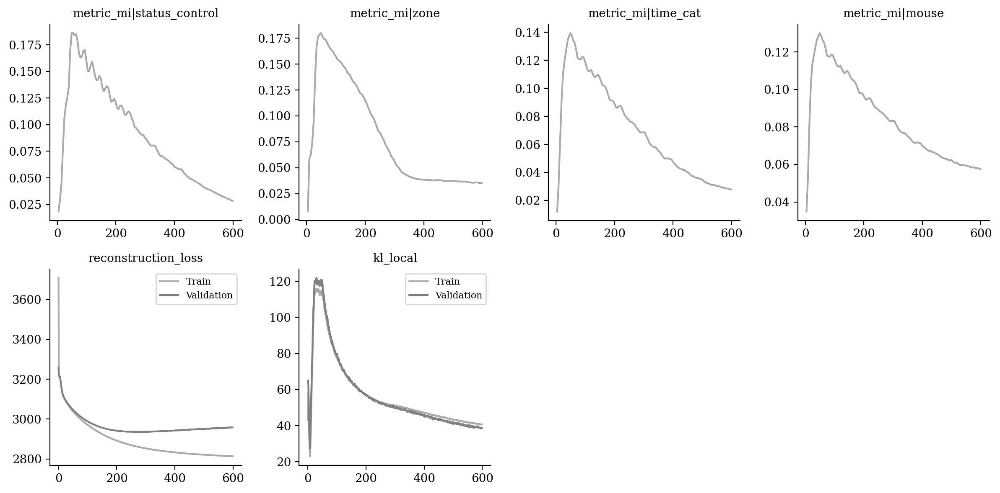

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

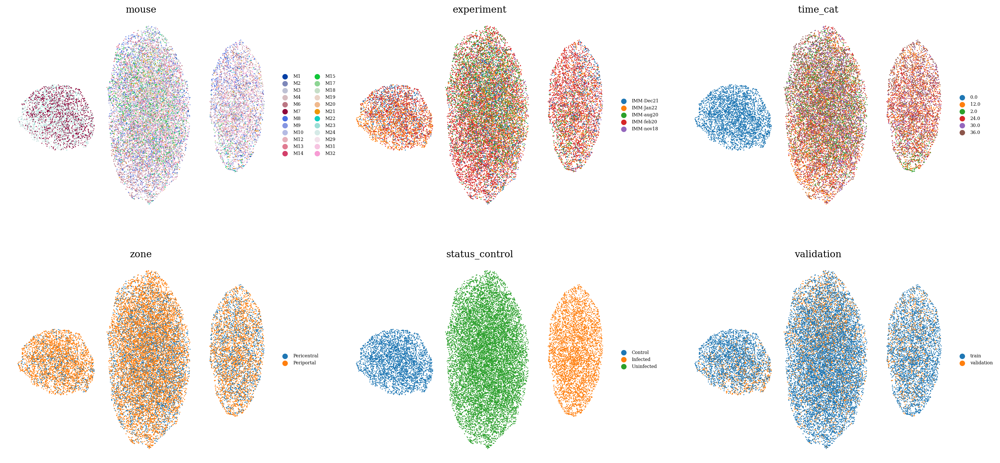

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

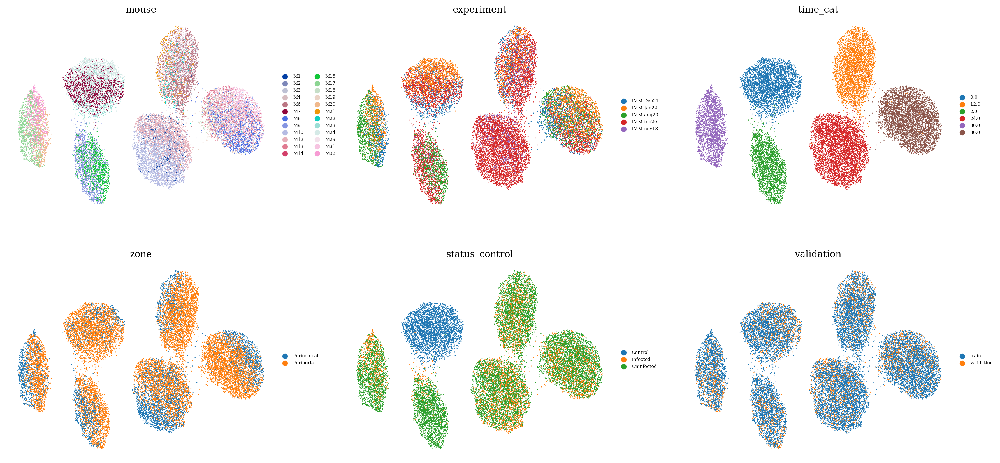

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

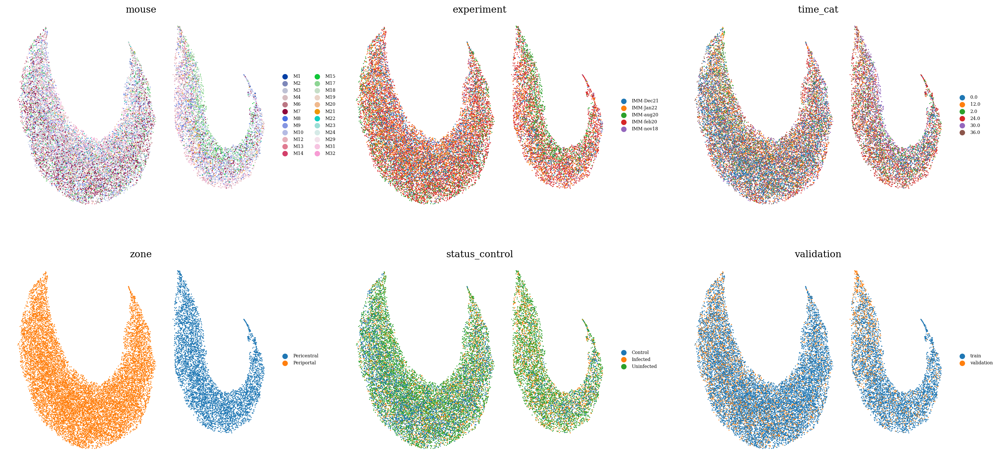

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

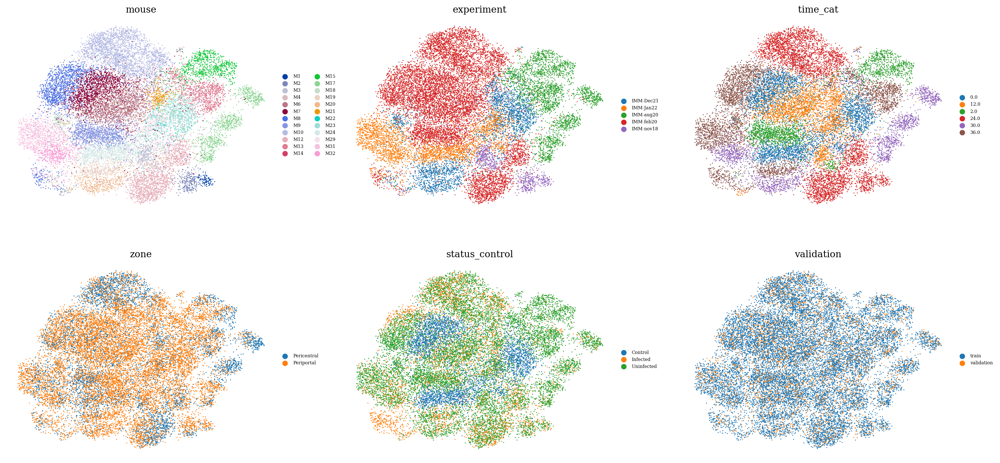

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

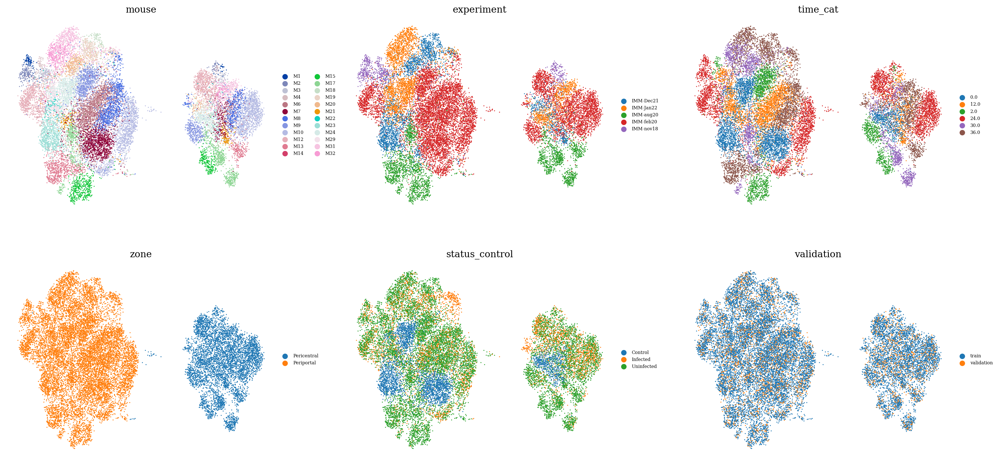

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

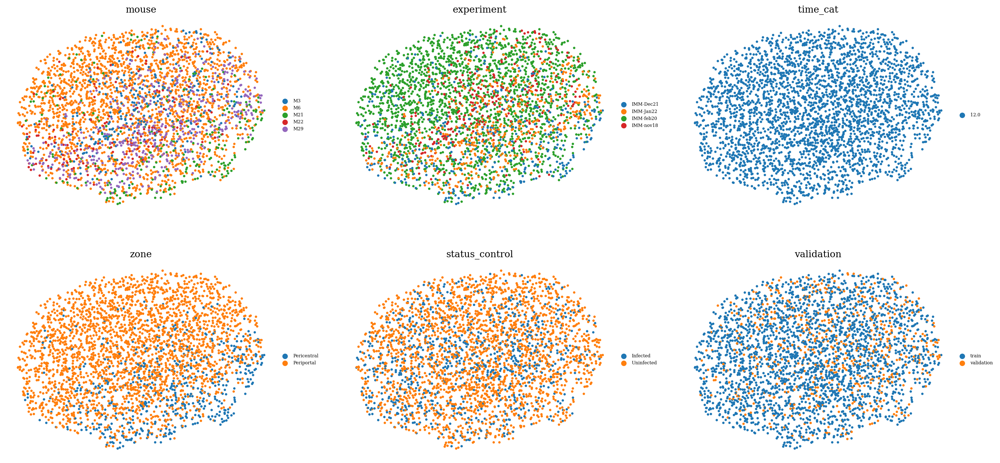

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )